In [ ]:
!pip install pandas_ta yfinance pandas_ta lightgbm matplotlib

# Intro

We are using machine learning to select a few technical indicators from a list of 181 technical features (indictators, statistics, etc)
1. USD pairs - Run on a subset of USD pair universe (selected based on the data from yfinance and if the data available is good enough - regular intervals)
2. Intervals - We will try to test on 1min and 5min intervals first
3. Position Sizing - Equal proportion for each selected USD pair based on the total realized and unrealized balance
4. Feature Selection - Top 15 of the first initial machine learning model. And reduce by 1 each run to determine the most efficient number of top features to be used in the final fine tuned model.
5. Out of Sample Test - Machine Learning feature selection and fine tuning is done on training data. Model will be trained and tested to check its profitability through out of sample test data. Machine Learning algo will be trained using expanding window through its in-sample training data (through time series split)
6. Event Based Back Testing - Model will be tested using event based back testing for each currency pairs using the out of sample data

# 1. Start with 1min Interval

### 1.1 Preparing the data
- For symbols in the format: "ABC=X", the price will be inverted (1/price) to get the actual USD price per ABC currency
- returns will be computed using closing price
- returns_1 will be computed too, which is the next day close price return (t+1) for model prediction

In [ ]:
import yfinance as yf
import pandas as pd
import pandas_ta
import warnings
warnings.filterwarnings("ignore")

#symbols = ["EURUSD=X", "JPY=X", "GBPUSD=X", "AUDUSD=X", "NZDUSD=X","CNY=X","HKD=X","SGD=X","INR=X","MXN=X","PHP=X","IDR=X","THB=X", "MYR=X","ZAR=X","RUB=X"]

# NZDUSD is in 2mins interval, CNY=X, INR=X, PHP=X, IDR=X, THB=X, MYR=X, RUB=X data are not in regular interval, may have problem training model
#  therefore Drop NZDUSD, CNY=X, INR=X, PHP=X, IDR=X, THB=X, MYR=X, RUB=X
symbols = ["EURUSD=X", "JPY=X", "GBPUSD=X", "AUDUSD=X","HKD=X","SGD=X","MXN=X","ZAR=X"]

prices = dict()

# Fetch historical data
for symbol in symbols:
  data = yf.Ticker(symbol)
  # Feature selection from 28 Mar 2024 to 3 Apr 2024, Out-of-Sample backtesting from 4 Apr 2024 to 10 Apr 2024
  prices[symbol] = data.history(start="2024-03-28", end="2024-04-03", interval = '1M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices[symbol] = 1 / prices[symbol]

  prices[symbol]["Returns"] = prices[symbol]["Close"].pct_change()
  prices[symbol]["Returns_1"] = prices[symbol]["Returns"].shift(-1)

### 1.2 Computing all the 181 technical indicators for each selected currency pair

In [ ]:
for symbol in symbols:
  entropy_df = pandas_ta.statistics.entropy(prices[symbol]["Close"])
  kurtosis_df = pandas_ta.statistics.kurtosis(prices[symbol]["Close"])
  mad_df = pandas_ta.statistics.mad(prices[symbol]["Close"])
  median_df = pandas_ta.statistics.median(prices[symbol]["Close"])
  skew_df = pandas_ta.statistics.skew(prices[symbol]["Close"])
  stdev_df = pandas_ta.statistics.stdev(prices[symbol]["Close"])
  tosstdev_df = pandas_ta.statistics.tos_stdevall(prices[symbol]["Close"])
  var_df = pandas_ta.statistics.variance(prices[symbol]["Close"])
  zscore_df = pandas_ta.statistics.zscore(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], entropy_df, kurtosis_df, mad_df, median_df, skew_df, stdev_df, tosstdev_df, var_df, zscore_df], axis=1)

In [ ]:
# pandas_ta using the depreciated append function. until it is updated... we use this hack
pd.Series.append = pd.Series._append

for symbol in symbols:
  alma_df = pandas_ta.overlap.alma(prices[symbol]["Close"])
  dema_df = pandas_ta.overlap.dema(prices[symbol]["Close"])
  ema_df = pandas_ta.overlap.ema(prices[symbol]["Close"])
  fwma_df = pandas_ta.overlap.fwma(prices[symbol]["Close"])
  hilo_df = pandas_ta.overlap.hilo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  hl2_df = pandas_ta.overlap.hl2(prices[symbol]["High"], prices[symbol]["Low"])
  hlc3_df = pandas_ta.overlap.hlc3(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  hma_df = pandas_ta.overlap.hma(prices[symbol]["Close"])
  hwma_df = pandas_ta.overlap.hwma(prices[symbol]["Close"])
  ichimoku_df = pandas_ta.overlap.ichimoku(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  jma_df = pandas_ta.overlap.jma(prices[symbol]["Close"])
  kama_df = pandas_ta.overlap.kama(prices[symbol]["Close"])
  linreg_df = pandas_ta.overlap.linreg(prices[symbol]["Close"])
  mcgd_df = pandas_ta.overlap.mcgd(prices[symbol]["Close"])
  midpoint_df = pandas_ta.overlap.midpoint(prices[symbol]["Close"])
  midprice_df = pandas_ta.overlap.midprice(prices[symbol]["High"], prices[symbol]["Low"])
  ohlc4_df = pandas_ta.overlap.ohlc4(prices[symbol]["Open"],prices[symbol]["High"], prices[symbol]["Low"],prices[symbol]["Close"])
  pwma_df = pandas_ta.overlap.pwma(prices[symbol]["Close"])
  rma_df = pandas_ta.overlap.rma(prices[symbol]["Close"])
  sinwma_df = pandas_ta.overlap.sinwma(prices[symbol]["Close"])
  sma_df = pandas_ta.overlap.sma(prices[symbol]["Close"])
  ssf_df = pandas_ta.overlap.ssf(prices[symbol]["Close"])
  supertrend_df = pandas_ta.overlap.supertrend(prices[symbol]["High"], prices[symbol]["Low"],prices[symbol]["Close"])
  swma_df = pandas_ta.overlap.swma(prices[symbol]["Close"])
  t3_df = pandas_ta.overlap.t3(prices[symbol]["Close"])
  tema_df = pandas_ta.overlap.tema(prices[symbol]["Close"])
  trima_df = pandas_ta.overlap.trima(prices[symbol]["Close"])
  vidya_df = pandas_ta.overlap.vidya(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], alma_df, dema_df, ema_df, fwma_df, hilo_df, hl2_df, hlc3_df, hma_df, hwma_df, ichimoku_df[0], jma_df, kama_df, linreg_df, mcgd_df, midpoint_df, midprice_df, ohlc4_df, pwma_df, rma_df, sinwma_df, sma_df, ssf_df, supertrend_df, swma_df, t3_df, tema_df, trima_df, vidya_df], axis=1)

In [ ]:
# prompt: generate the same for pandas_ta.trend

for symbol in symbols:
  adx_df = pandas_ta.trend.adx(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  aroon_df = pandas_ta.trend.aroon(prices[symbol]["High"], prices[symbol]["Low"])
  chop_df = pandas_ta.trend.chop(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cksp_df = pandas_ta.trend.cksp(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  decay_df = pandas_ta.trend.decay(prices[symbol]["Close"])
  decreasing_df = pandas_ta.trend.decreasing(prices[symbol]["Close"])
  dpo_df = pandas_ta.trend.dpo(prices[symbol]["Close"])
  increasing_df = pandas_ta.trend.increasing(prices[symbol]["Close"])
  psar_df = pandas_ta.trend.psar(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  qstick_df = pandas_ta.trend.qstick(prices[symbol]["Open"], prices[symbol]["Close"])
  ttm_df = pandas_ta.trend.ttm_trend(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  vhf_df = pandas_ta.trend.vhf(prices[symbol]["Close"])
  vortex_df = pandas_ta.trend.vortex(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], adx_df, aroon_df, chop_df, cksp_df, dpo_df, decay_df, decreasing_df, increasing_df, psar_df, qstick_df, ttm_df, vhf_df, vortex_df], axis=1)


In [ ]:
# prompt: generate the same for pandas_ta.momentum

for symbol in symbols:
  ao_df = pandas_ta.momentum.ao(prices[symbol]["High"], prices[symbol]["Low"])
  apo_df = pandas_ta.momentum.apo(prices[symbol]["Close"])
  bias_df = pandas_ta.momentum.bias(prices[symbol]["Close"])
  bop_df = pandas_ta.momentum.bop(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  brar_df = pandas_ta.momentum.brar(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cci_df = pandas_ta.momentum.cci(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cfo_df = pandas_ta.momentum.cfo(prices[symbol]["Close"])
  cg_df = pandas_ta.momentum.cg(prices[symbol]["Close"])
  cmo_df = pandas_ta.momentum.cmo(prices[symbol]["Close"])
  coppock_df = pandas_ta.momentum.coppock(prices[symbol]["Close"])
  cti_df = pandas_ta.momentum.cti(prices[symbol]["Close"])
  dm_df = pandas_ta.momentum.dm(prices[symbol]["High"], prices[symbol]["Low"])
  er_df = pandas_ta.momentum.er(prices[symbol]["Close"])
  eri_df = pandas_ta.momentum.eri(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  fisher_df = pandas_ta.momentum.fisher(prices[symbol]["High"], prices[symbol]["Low"])
  kdj_df = pandas_ta.momentum.kdj(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  kst_df = pandas_ta.momentum.kst(prices[symbol]["Close"])
  macd_df = pandas_ta.momentum.macd(prices[symbol]["Close"])
  mom_df = pandas_ta.momentum.mom(prices[symbol]["Close"])
  pgo_df = pandas_ta.momentum.pgo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ppo_df = pandas_ta.momentum.ppo(prices[symbol]["Close"])
  psl_df = pandas_ta.momentum.psl(prices[symbol]["Close"])
  #pvo_df = pandas_ta.momentum.pvo(prices[symbol]["Volume"]) #no volume data`
  qqe_df = pandas_ta.momentum.qqe(prices[symbol]["Close"])
  roc_df = pandas_ta.momentum.roc(prices[symbol]["Close"])
  rsi_df = pandas_ta.momentum.rsi(prices[symbol]["Close"])
  rsx_df = pandas_ta.momentum.rsx(prices[symbol]["Close"])
  rvgi_df = pandas_ta.momentum.rvgi(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  slope_df = pandas_ta.momentum.slope(prices[symbol]["Close"])
  smi_df = pandas_ta.momentum.smi(prices[symbol]["Close"])
  squeeze_df = pandas_ta.momentum.squeeze(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  squeezepro_df = pandas_ta.momentum.squeeze_pro(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  stc_df = pandas_ta.momentum.stc(prices[symbol]["Close"])
  stoch_df = pandas_ta.momentum.stoch(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  stochrsi_df = pandas_ta.momentum.stochrsi(prices[symbol]["Close"])
  #tdseq_df = pandas_ta.momentum.td_seq(prices[symbol]["Close"]) #this cause the dataframe to go crazy when concat
  trix_df = pandas_ta.momentum.trix(prices[symbol]["Close"])
  tsi_df = pandas_ta.momentum.tsi(prices[symbol]["Close"])
  uo_df = pandas_ta.momentum.uo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  willr_df = pandas_ta.momentum.willr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  #prices[symbol] = pd.concat([prices[symbol], ao_df, apo_df, bias_df, bop_df, brar_df, cci_df, cfo_df, cg_df, cmo_df, coppock_df, cti_df, dm_df, er_df, eri_df, fisher_df, kdj_df, kst_df, macd_df, mom_df, pgo_df, ppo_df, psl_df, qqe_df, roc_df, rsi_df, rsx_df, rvgi_df, slope_df, smi_df, squeeze_df, squeezepro_df, stc_df, stoch_df, stochrsi_df, trix_df, tsi_df, uo_df, willr_df], axis=1)
  prices[symbol] = pd.concat([prices[symbol], ao_df, apo_df, bias_df, bop_df, brar_df, cci_df, cfo_df, cg_df, cmo_df, coppock_df, cti_df, dm_df, er_df, eri_df, fisher_df, kdj_df, kst_df, macd_df, mom_df, pgo_df, ppo_df, psl_df, qqe_df, roc_df, rsi_df, rsx_df, rvgi_df, slope_df, smi_df, squeeze_df, squeezepro_df, stc_df, stoch_df, stochrsi_df, trix_df, tsi_df, uo_df, willr_df], axis=1)


In [ ]:
# prompt: generate the same for pandas_ta.volatility
from pandas_ta.volatility import aberration, accbands, atr, bbands, donchian, hwc, kc, massi, natr, pdist, rvi, thermo, true_range, ui

for symbol in symbols:
  aberration_df = aberration(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  accbands_df = accbands(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  atr_df = atr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  bbands_df = bbands(prices[symbol]["Close"])
  donchian_df = donchian(prices[symbol]["High"], prices[symbol]["Low"])
  hwc_df = hwc(prices[symbol]["Close"])
  kc_df = kc(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  massi_df = massi(prices[symbol]["High"], prices[symbol]["Low"])
  natr_df = natr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  pdist_df = pdist(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  rvi_df = rvi(prices[symbol]["Close"], prices[symbol]["High"], prices[symbol]["Low"])
  thermo_df = thermo(prices[symbol]["High"], prices[symbol]["Low"])
  truerange_df = true_range(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ui_df = ui(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], aberration_df, accbands_df, atr_df, bbands_df, donchian_df, hwc_df, kc_df, massi_df, natr_df, pdist_df, rvi_df, thermo_df, ui_df, truerange_df], axis=1)


In [ ]:
# prompt: generate the same for pandas_ta.candles

for symbol in symbols:
  doji_df = pandas_ta.candles.cdl_doji(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  inside_df = pandas_ta.candles.cdl_inside(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  z_df = pandas_ta.candles.cdl_z(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ha_df = pandas_ta.candles.ha(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])


  prices[symbol] = pd.concat([prices[symbol], doji_df, inside_df, z_df, ha_df], axis=1)



Delete duplicated features

In [ ]:
for symbol in symbols:
  prices[symbol] = prices[symbol].drop(columns=["DMP_14", "DMN_14"]) #drop duplicates

Have a look on the data

In [ ]:
prices["EURUSD=X"].tail()

,Open,High,Low,Close,Returns,Returns_1,ENTP_10,KURT_30,MAD_30,MEDIAN_30,...,CDL_DOJI_10_0.1,CDL_INSIDE,open_Z_30_1,high_Z_30_1,low_Z_30_1,close_Z_30_1,HA_open,HA_high,HA_low,HA_close
Datetime,,,,,,,,,,,,,,,,,,,,,
2024-04-02 23:54:00+01:00,1.077122,1.077122,1.077122,1.077122,-0.000108,-0.000108,3.321847,-0.168346,0.000053,1.077238,...,0,0,-2.170136,-2.170136,-2.170136,-2.170136,1.077213,1.077213,1.077122,1.077122
2024-04-02 23:55:00+01:00,1.077006,1.077006,1.077006,1.077006,-0.000108,0.000108,3.321799,2.013193,0.000058,1.077238,...,0,0,-3.099968,-3.099968,-3.099968,-3.099968,1.077167,1.077167,1.077006,1.077006
2024-04-02 23:56:00+01:00,1.077122,1.077122,1.077122,1.077122,0.000108,0.000000,3.321776,1.247958,0.000060,1.077238,...,0,0,-1.551881,-1.551881,-1.551881,-1.551881,1.077087,1.077122,1.077087,1.077122
2024-04-02 23:57:00+01:00,1.077122,1.077122,1.077122,1.077122,0.000000,0.000000,3.321760,0.655078,0.000063,1.077238,...,0,0,-1.449551,-1.449551,-1.449551,-1.449551,1.077104,1.077122,1.077104,1.077122
2024-04-02 23:58:00+01:00,1.077122,1.077122,1.077122,1.077122,0.000000,NaN,3.321750,0.187970,0.000065,1.077238,...,0,0,-1.358958,-1.358958,-1.358958,-1.358958,1.077113,1.077122,1.077113,1.077122


### 1.3 First Initial Machine Learning
- First run to select the top 15 indicators to use

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

results = {}
average_accuracy = 0

for symbol in symbols:
  # Drop na for returns(t+1)
  data = prices[symbol].dropna(subset=["Returns_1"])

  # Split train data and test data, before and after 2 Apr 2024 respectively
  train_data = data.loc[data.index <= "2024-04-02"] # 3 days of train data
  test_data = data.loc[data.index > "2024-04-02"] # 2 days of test data

  # Get X and y
  X_train = train_data.drop(columns=["Returns", "Returns_1"], axis=1)
  y_train = train_data["Returns_1"]
  X_test = test_data.drop(columns=["Returns", "Returns_1"], axis=1)
  y_test = test_data["Returns_1"]

  model = lgb.LGBMRegressor(n_estimators=200, learning_rate=0.1, random_state=42)

  param_grid = {
      'n_estimators': [200],
      'learning_rate': [0.1],
      #'max_depth': range(2, 6),
      'num_leaves': [30],
      'verbose': [-1]
  }

  # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
  grid_search.fit(X_train, y_train)

  # Best model
  best_params = grid_search.best_params_
  best_score = grid_search.best_score_
  print("\nScore and Feature Importance for ", symbol)
  print(f"Best parameters: {best_params}")
  print(f"Best validation R-squared score: {best_score}")

  best_model = grid_search.best_estimator_

  # Make predictions on the test set
  y_pred = best_model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5

  print("RMSE:", rmse)

  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Price Direction Accuracy:", accuracy)

  average_accuracy += accuracy

  # Get the feature importance
  importances = best_model.feature_importances_

  # Create a dataframe with feature importance
  feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

  results[symbol] = {
      "best_estimator_": best_model,
      "best_params": best_params,
      "best_score": best_score,
      "rmse": rmse,
      "accuracy": accuracy
  }

  # Sort the dataframe by importance
  feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  # Print the top 15 most important features
  print(feature_importance_df.head(15))

print("Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))


Score and Feature Importance for  EURUSD=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'num_leaves': 30, 'verbose': -1}
Best validation R-squared score: 0.10557068906085995
RMSE: 8.654134827445825e-05
Price Direction Accuracy: 0.6214135759272218
                 feature  importance
63                DPO_20         381
83                 CFO_9         136
8                SKEW_30         121
141           UO_7_14_28         116
5                KURT_30         115
95                 J_9_3         106
154            BBB_5_2.0         106
60         CHOP_14_1_100         105
89              BULLP_13         103
155            BBP_5_2.0         102
87                CTI_12         101
73                VHF_28         100
120    SQZ_20_2.0_20_1.5          95
119          SMIo_5_20_5          94
135  STOCHRSIk_14_14_3_3          92

Score and Feature Importance for  JPY=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'num_leaves': 30, 'verbose': -1}
Best vali

Arrange and display all the top 15 features across all currency pairs

In [ ]:
feature_importances = pd.DataFrame(index=prices[symbol].drop(columns=["Returns", "Returns_1"], axis=1).columns)
for symbol in symbols:
  feature_importances[symbol] = results[symbol]["best_estimator_"].feature_importances_

feature_importances["sum"] = feature_importances.sum(axis=1)
feature_importances.sort_values(by="sum", ascending=False).head(15)

,EURUSD=X,JPY=X,GBPUSD=X,AUDUSD=X,HKD=X,SGD=X,MXN=X,ZAR=X,sum
DPO_20,381,303,418,302,240,333,270,263,2510
SLOPE_1,55,145,114,149,123,156,143,125,1010
BBB_5_2.0,106,123,136,85,84,201,104,100,939
CFO_9,136,120,146,123,110,126,85,88,934
BULLP_13,103,103,75,75,142,114,122,106,840
THERMO_20_2_0.5,2,120,13,141,79,231,106,116,808
KURT_30,115,105,88,79,105,94,79,122,787
ER_10,77,101,113,126,84,95,81,92,769
RVI_14,78,106,119,95,81,72,85,92,728
BEARP_13,0,84,0,87,135,129,158,110,703


Save the top15 features

In [ ]:
selected_features = feature_importances.sort_values(by="sum", ascending=False).head(15).index
selected_features

Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_9', 'BULLP_13',
       'THERMO_20_2_0.5', 'KURT_30', 'ER_10', 'RVI_14', 'BEARP_13', 'PDIST',
       'BBP_5_2.0', 'VHF_28', 'THERMOma_20_2_0.5', 'SMIo_5_20_5'],
      dtype='object')

### 1.4 Iterate the machine learning algo for the top15 indicators, dropping 1 indicators each run and see its performance (accuracy of price direction)

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

results_iterate = {}
average_accuracy = 0
selected_features_scores = pd.DataFrame()

# keep iterating and removing 1 least important feature until we selected 2 most important feature
while len(selected_features) > 2:
  average_accuracy = 0
  for symbol in symbols:
    # Drop na for returns(t+1)
    data = prices[symbol].dropna(subset=["Returns_1"])

    # Split train data and test data, before and after 2 Apr 2024 respectively
    train_data = data.loc[data.index <= "2024-04-02"] # 3 days of train data
    test_data = data.loc[data.index > "2024-04-02"] # 2 days of test data

    # Get X and y
    X_train = train_data[selected_features]
    y_train = train_data["Returns_1"]
    X_test = test_data[selected_features]
    y_test = test_data["Returns_1"]

    model = lgb.LGBMRegressor(n_estimators=200, learning_rate=0.1, random_state=42)

    param_grid = {
        'n_estimators': [200],
        'learning_rate': [0.1],
        #'max_depth': range(2, 6),
        'num_leaves': [30],
        'verbose': [-1]
    }

    # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
    grid_search.fit(X_train, y_train)

    best_model = grid_search.best_estimator_

    # Make predictions on the test set
    y_pred = best_model.predict(X_test)

    y_test_binary = [1 if x > 0 else 0 for x in y_test]
    y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

    accuracy = accuracy_score(y_test_binary, y_pred_binary)
    print("Price Direction Test Accuracy for {}: {}".format(symbol,accuracy))

    average_accuracy += accuracy

    # Get the feature importance
    importances = best_model.feature_importances_

    # Create a dataframe with feature importance
    feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

    # Sort the dataframe by importance
    feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  print("Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))
  feature_accuracy = pd.DataFrame({
      'features': [selected_features],
      'accuracy': [average_accuracy/len(symbols)]
  })
  selected_features_scores = pd.concat([selected_features_scores,feature_accuracy], ignore_index=True)

  # get the top features
  feature_importances = pd.DataFrame(index=prices[symbol].drop(columns=["Returns", "Returns_1"], axis=1).columns)
  for symbol in symbols:
    feature_importances[symbol] = results[symbol]["best_estimator_"].feature_importances_

  feature_importances["sum"] = feature_importances.sum(axis=1)
  sorted_importances = feature_importances.sort_values(by="sum", ascending=False)
  dropped_feature = sorted_importances.tail(1).index[0]
  # Select new feature by dropping the lowest importance
  selected_features = sorted_importances.head(len(selected_features) - 1).index
  print("*" * 30)
  print("Selected {} features".format(len(selected_features)))
  print("Selected: ", selected_features)
  print("Dropped: ", dropped_feature)

Price Direction Test Accuracy for EURUSD=X: 0.5976207137858642
Price Direction Test Accuracy for JPY=X: 0.6334494773519164
Price Direction Test Accuracy for GBPUSD=X: 0.6258741258741258
Price Direction Test Accuracy for AUDUSD=X: 0.6424541607898449
Price Direction Test Accuracy for HKD=X: 0.6508710801393728
Price Direction Test Accuracy for SGD=X: 0.6536585365853659
Price Direction Test Accuracy for MXN=X: 0.705226480836237
Price Direction Test Accuracy for ZAR=X: 0.6919263456090652
Average Price Direction Test Accuracy:  0.650135115121474
******************************
Selected 14 features
Selected:  Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_9', 'BULLP_13',
       'THERMO_20_2_0.5', 'KURT_30', 'ER_10', 'RVI_14', 'BEARP_13', 'PDIST',
       'BBP_5_2.0', 'VHF_28', 'THERMOma_20_2_0.5'],
      dtype='object')
Dropped:  HA_close
Price Direction Test Accuracy for EURUSD=X: 0.5990202939118264
Price Direction Test Accuracy for JPY=X: 0.627177700348432
Price Direction Test Accuracy for GBP

Display the features used and its corresponding accuracy

In [ ]:
selected_features_scores.set_index(selected_features_scores['features'].apply(len), inplace=True)
selected_features_scores

,features,accuracy
features,,
15,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.650135
14,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.652144
13,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.648541
12,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.650023
11,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.649735
10,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.649767
9,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.650463
8,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.651848
7,"Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0', 'CFO_...",0.649394


Since accuracy does not change much compared between 15 top features to 3 top features, we use only the top 3 features

In [ ]:
top_3_features = selected_features_scores.loc[3,"features"]
top_3_features

Index(['DPO_20', 'SLOPE_1', 'BBB_5_2.0'], dtype='object')

### 1.5 Built the data again only for the selected top 3 indicators

In [ ]:
from pandas_ta.volatility import bbands

def get_top3_features(high, low, close):
  # top 3 features 'DPO_20', 'BBB_5_2.0', 'SLOPE_1'
  dpo_df = pandas_ta.trend.dpo(close)
  bbands_df = bbands(close)
  slope_df = pandas_ta.momentum.slope(close)

  combined = pd.concat([dpo_df, bbands_df, slope_df], axis=1)
  return combined[top_3_features].copy()

symbols = ["EURUSD=X", "JPY=X", "GBPUSD=X", "AUDUSD=X","HKD=X","SGD=X","MXN=X","ZAR=X"]
prices2 = dict()

for symbol in symbols:
  # Feature selection from 28 Mar 2024 to 3 Apr 2024, same data is used to train the model again with the top features with fine tuning
  prices2[symbol] = yf.Ticker(symbol).history(start="2024-03-28", end="2024-04-03", interval = '1M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices2[symbol] = 1 / prices2[symbol]

  #top6_df = get_top6_features(prices2[symbol]["High"], prices2[symbol]["Low"], prices2[symbol]["Close"])
  #prices2[symbol] = pd.concat([prices2[symbol], top6_df], axis=1)
  top3_df = get_top3_features(prices2[symbol]["High"], prices2[symbol]["Low"], prices2[symbol]["Close"])
  prices2[symbol] = pd.concat([prices2[symbol], top3_df], axis=1)
  prices2[symbol]["Returns"] = prices[symbol]["Close"].pct_change()
  prices2[symbol]["Returns_1"] = prices[symbol]["Returns"].shift(-1) # move backwards the returns row, so that the model can  predict the returns(t+1) using the current row indicators

### 1.6 Train and fine tune the models again using the selected top features

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

results = {}
average_accuracy = 0

for symbol in symbols:
  # Drop na for returns(t+1)
  data = prices2[symbol].dropna(subset=["Returns_1"])

  # Split train data and test data, before and after 2 Apr 2024 respectively
  train_data = data.loc[data.index <= "2024-04-02"] # 3 days of train data
  test_data = data.loc[data.index > "2024-04-02"] # 2 days of test data

  # Get X and y
  X_train = train_data[top_3_features]
  y_train = train_data["Returns_1"]
  X_test = test_data[top_3_features]
  y_test = test_data["Returns_1"]

  model = lgb.LGBMRegressor(random_state=42)

  param_grid = {
      'n_estimators': range(20,100,10),
      'learning_rate': [0.05, 0.06, 0.07, 0.08, 0.09, 0.1],
      #'max_depth': range(2, 6),
      'num_leaves': [5,10,15,20],
      'verbose': [-1]
  }

  # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
  grid_search.fit(X_train, y_train)

  # Best model
  best_params = grid_search.best_params_
  best_score = grid_search.best_score_
  print("\nScore for", symbol)
  print(f"Best parameters: {best_params}")
  print(f"Best validation R-squared score: {best_score}")

  best_model = grid_search.best_estimator_

  # Make predictions on the test set
  y_pred = best_model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5

  print("RMSE:", rmse)

  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Test Price Direction Accuracy:", accuracy)

  average_accuracy += accuracy

  results[symbol] = {
      "best_estimator_": best_model,
      "best_params": best_params,
      "best_score": best_score,
      "rmse": rmse,
      "accuracy": accuracy
  }

print("Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))


Score for EURUSD=X
Best parameters: {'learning_rate': 0.06, 'n_estimators': 70, 'num_leaves': 5, 'verbose': -1}
Best validation R-squared score: 0.2043165705221899
RMSE: 7.872097171125538e-05
Test Price Direction Accuracy: 0.6829951014695591

Score for JPY=X
Best parameters: {'learning_rate': 0.06, 'n_estimators': 40, 'num_leaves': 10, 'verbose': -1}
Best validation R-squared score: 0.19979717947533723
RMSE: 5.8218170099507976e-05
Test Price Direction Accuracy: 0.6146341463414634

Score for GBPUSD=X
Best parameters: {'learning_rate': 0.09, 'n_estimators': 30, 'num_leaves': 5, 'verbose': -1}
Best validation R-squared score: 0.16490673195842084
RMSE: 7.430959210785135e-05
Test Price Direction Accuracy: 0.6391608391608392

Score for AUDUSD=X
Best parameters: {'learning_rate': 0.06, 'n_estimators': 50, 'num_leaves': 5, 'verbose': -1}
Best validation R-squared score: 0.15660098293210697
RMSE: 0.00010407890652891579
Test Price Direction Accuracy: 0.652327221438646

Score for HKD=X
Best para

### 1.7 Prepare the test data (from 4 Apr to 10 Apr) for evaluation. Run the models. First we compute the test accuracy

In [ ]:
prices3 = dict()

for symbol in symbols:
  prices3[symbol] = yf.Ticker(symbol).history(start="2024-04-04", end="2024-04-10", interval = '1M').drop(columns=["Volume","Dividends","Stock Splits"])
  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices3[symbol] = 1 / prices3[symbol]

  top3_df3 = get_top3_features(prices3[symbol]["High"], prices3[symbol]["Low"], prices3[symbol]["Close"])
  prices3[symbol] = pd.concat([prices3[symbol], top3_df3], axis=1)
  prices3[symbol]["Returns"] = prices3[symbol]["Close"].pct_change()
  prices3[symbol]["Returns_1"] = prices3[symbol]["Returns"].shift(-1)
  prices3[symbol]["Returns_1"] = prices3[symbol]["Returns_1"].fillna(0) # fill the last cell with 0 since we do not have returns t+1 for last row

  # drop any na values. we dont want to trade on any na indicators
  data = prices3[symbol].dropna(subset=['Returns_1'])

  # Model Prediction
  model = results[symbol]["best_estimator_"]
  X_test = data[top_3_features]
  y_test = data["Returns_1"]
  y_pred = model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5
  print("-" * 20)
  print("For", symbol, ':')
  print("RMSE:", rmse)

  # Calculate the accuracy
  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  prices3[symbol]["signal"] = [1 if x > 0 else -1 for x in y_pred]
  #prices3[symbol]["signal_test"] = [1 if x > 0 else -1 for x in y_test]
  prices3[symbol]["buy_on_close"] = prices3[symbol]["signal"].shift()
  prices3[symbol]["periodic_strategy_return"] = prices3[symbol]["buy_on_close"] * prices3[symbol]["Returns"]

  positive_count = len(prices3[symbol][prices3[symbol]["periodic_strategy_return"] > 0])
  negative_count = len(prices3[symbol][prices3[symbol]["periodic_strategy_return"] < 0])

  print(f"Number of positive return periods (1min): {positive_count}")
  print(f"Number of negative return periods (1min): {negative_count}")

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Price Direction Accuracy:", accuracy)

--------------------
For EURUSD=X :
RMSE: 8.937505482046195e-05
Number of positive return periods (1min): 1802
Number of negative return periods (1min): 523
Price Direction Accuracy: 0.6286019210245464
--------------------
For JPY=X :
RMSE: 7.426049288719785e-05
Number of positive return periods (1min): 3387
Number of negative return periods (1min): 1825
Price Direction Accuracy: 0.6388001419950302
--------------------
For GBPUSD=X :
RMSE: 9.061026570387388e-05
Number of positive return periods (1min): 3224
Number of negative return periods (1min): 1775
Price Direction Accuracy: 0.6307363927427961
--------------------
For AUDUSD=X :
RMSE: 0.00013010169663028138
Number of positive return periods (1min): 3349
Number of negative return periods (1min): 1773
Price Direction Accuracy: 0.6366076221148685
--------------------
For HKD=X :
RMSE: 2.0237095069331564e-05
Number of positive return periods (1min): 3496
Number of negative return periods (1min): 1179
Price Direction Accuracy: 0.6658969

### 1.8 Quick Vectorized Backtesting results

--------------------------------------------------
Total unleverage strategy return for EURUSD=X is 16.75%
Mean return is 0.003%
Standard Deviation for mean return is 0.0093%
Number of positive strategy return periods (15min): 1802
Number of negative strategy return periods (15min): 523


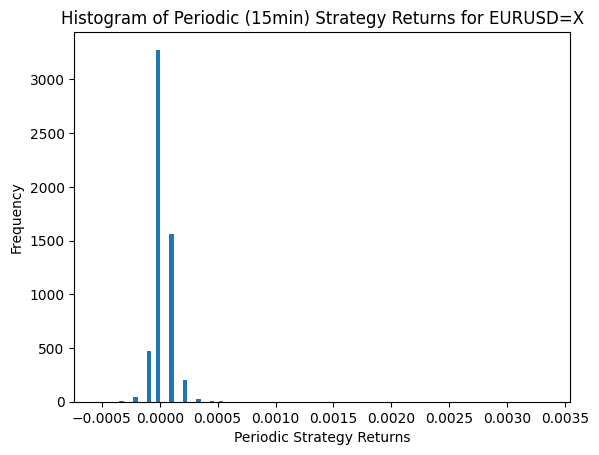

--------------------------------------------------
Total unleverage strategy return for JPY=X is 12.93%
Mean return is 0.0023%
Standard Deviation for mean return is 0.0077%
Number of positive strategy return periods (15min): 3378
Number of negative strategy return periods (15min): 1819


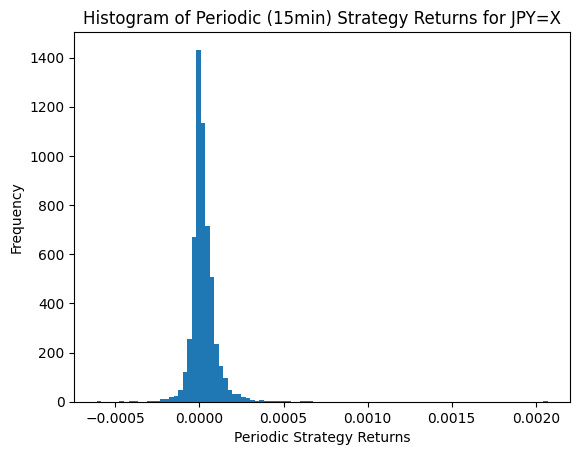

--------------------------------------------------
Total unleverage strategy return for GBPUSD=X is 14.45%
Mean return is 0.0026%
Standard Deviation for mean return is 0.0095%
Number of positive strategy return periods (15min): 3220
Number of negative strategy return periods (15min): 1766


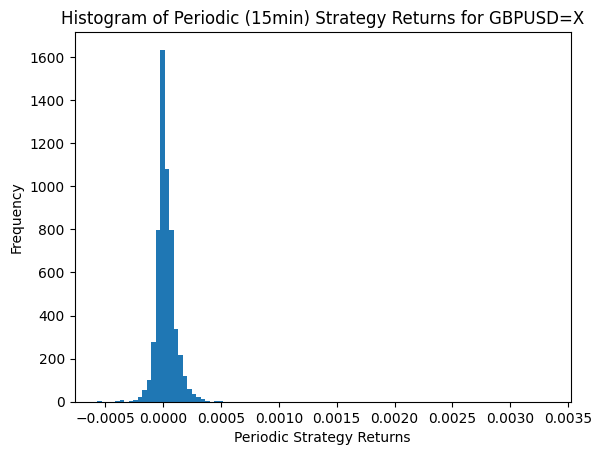

--------------------------------------------------
Total unleverage strategy return for AUDUSD=X is 23.72%
Mean return is 0.0043%
Standard Deviation for mean return is 0.0135%
Number of positive strategy return periods (15min): 3343
Number of negative strategy return periods (15min): 1764


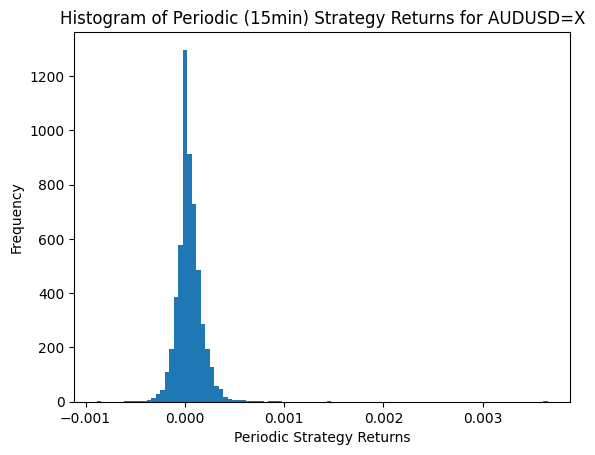

--------------------------------------------------
Total unleverage strategy return for HKD=X is 7.79%
Mean return is 0.0014%
Standard Deviation for mean return is 0.0022%
Number of positive strategy return periods (15min): 3487
Number of negative strategy return periods (15min): 1171


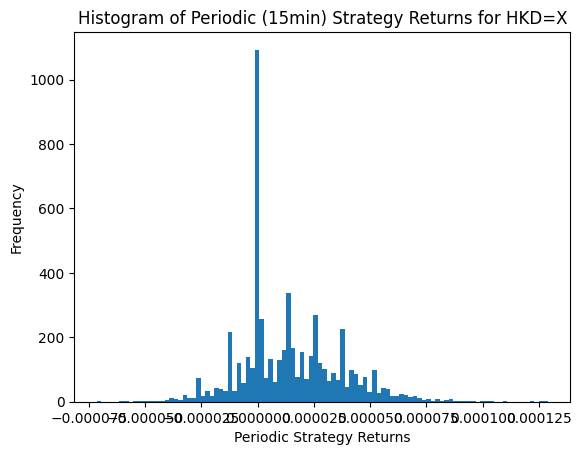

--------------------------------------------------
Total unleverage strategy return for SGD=X is 11.6%
Mean return is 0.0021%
Standard Deviation for mean return is 0.0073%
Number of positive strategy return periods (15min): 3270
Number of negative strategy return periods (15min): 1764


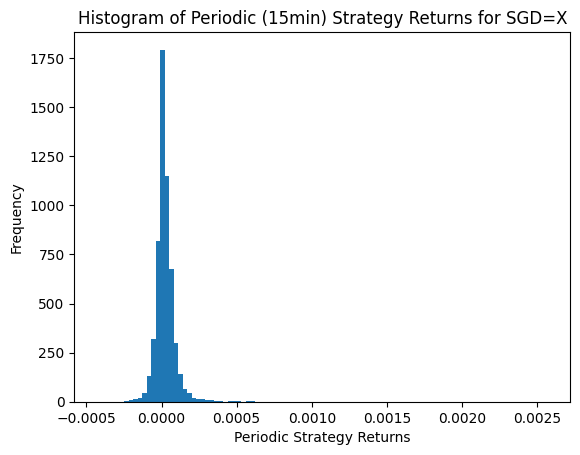

--------------------------------------------------
Total unleverage strategy return for MXN=X is 51.54%
Mean return is 0.0092%
Standard Deviation for mean return is 0.0211%
Number of positive strategy return periods (15min): 3635
Number of negative strategy return periods (15min): 1563


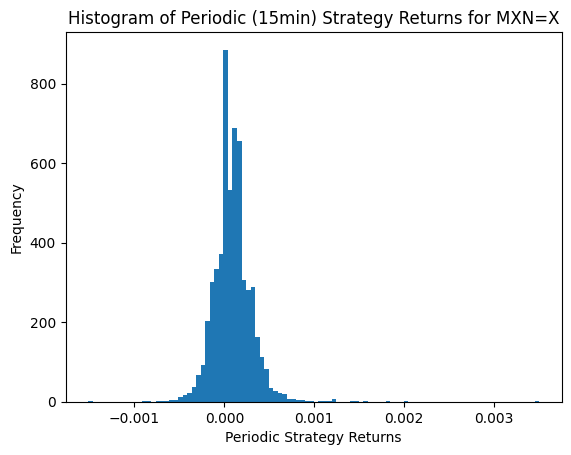

--------------------------------------------------
Total unleverage strategy return for ZAR=X is 49.54%
Mean return is 0.0089%
Standard Deviation for mean return is 0.0239%
Number of positive strategy return periods (15min): 3607
Number of negative strategy return periods (15min): 1879


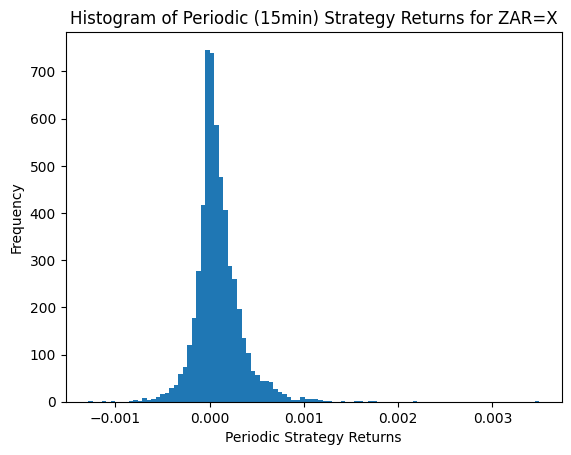

--------------------------------------------------
Total Portfolio Return: 188.32%


In [ ]:
import matplotlib.pyplot as plt

total_return = 0

for symbol in symbols:
  # drop all na, we dont trade if any indicator is na
  data = prices3[symbol].dropna().copy()

  # get the currency pair's model
  model = results[symbol]["best_estimator_"]

  # save the predicted y direction
  #   1 is positive => buy t+1, 0 is not positive => sell t+1
  y_pred = model.predict(data[top_3_features])
  data["signal"] = [1 if x > 0 else -1 for x in y_pred]
  # assumes we can buy only the next close period
  data["buy_on_close"] = data["signal"].shift()
  data["periodic_strategy_return"] = data["buy_on_close"] * data["Returns"]

  positive_count = len(data[data["periodic_strategy_return"] > 0])
  negative_count = len(data[data["periodic_strategy_return"] < 0])

  total_return += data["periodic_strategy_return"].sum()

  print("-" * 50)
  print("Total unleverage strategy return for {} is {}%".format(symbol, round(data["periodic_strategy_return"].sum() *100,2)))
  print("Mean return is {}%".format(round(data["periodic_strategy_return"].mean()*100,4)))
  print("Standard Deviation for mean return is {}%".format(round(data["periodic_strategy_return"].std()*100,4)))

  print(f"Number of positive strategy return periods (15min): {positive_count}")
  print(f"Number of negative strategy return periods (15min): {negative_count}")

  plt.hist(data["periodic_strategy_return"], bins=100)
  plt.title(f"Histogram of Periodic (15min) Strategy Returns for {symbol}")
  plt.xlabel("Periodic Strategy Returns")
  plt.ylabel("Frequency")
  plt.show()

print("-" * 50)
print("Total Portfolio Return: {}%".format(round(total_return*100,2)))

We note that the average strategy return per trade for all currency pairs are in the scale of 10^-5. This means that it is less than or around 1pip. If we assume a spread of 1pip we will likely lose money using this model

### 1.9 Event Based Backtesting

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

class Common_Class():

  def __init__(self, symbols, start, end, interval, capital, transcation_cost, verbose = True):
    print(symbols)
    self.symbols = symbols
    self.start = start
    self.end = end
    self.interval = interval

    self.initial_capital = capital # this is the initial capital you want to trade with
    self.capital = capital # this capital will change depending on trades
    self.transaction_cost = transcation_cost # the transaction cost for trading

    self.quantity = {symbol: 0 for symbol in symbols} # quantities to buy/sell
    self.position = {symbol: 0 for symbol in symbols} # the trades in progress, long or short
    self.trades = {symbol: 0 for symbol in symbols} # Number of trades
    self.data = dict()

    self.verbose = verbose # if you want to see detailed output (logs)

    self.prepare_data() # prepares the data

  def prepare_data(self):
    # since we are building a common class for all types of strategy, we will not calcualte the moving averages now.
    # we will calculate the returns though.
    # Since most strategies utilise close prices we are only factoring close price. However, you can alter acoordingly.

    for symbol in self.symbols:
      stock_data = yf.Ticker(symbol)
      hist_stock = stock_data.history(start = self.start, end = self.end, interval = self.interval)

      # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
      # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
      if len(symbol) == 5:
        hist_stock = 1 / hist_stock

      bt_data = pd.DataFrame()
      bt_data["Close_Price"] = hist_stock["Close"]
      bt_data["Return"] = np.log(bt_data["Close_Price"] / bt_data["Close_Price"].shift(1))
      bt_data["Open_Price"] = hist_stock["Open"]
      bt_data["Open_Return"] = np.log(bt_data["Open_Price"] / bt_data["Open_Price"].shift(1))
      bt_data["High"] = hist_stock["High"]
      bt_data["Low"] = hist_stock["Low"]

      bt_data = bt_data.dropna()
      self.data[symbol] = bt_data

  def return_date_close_price(self, symbol, bar):

    # A bar is a unit of data at a given time, depends on the interval you choose, it provides you OHLCV and time info
    # Since we have modeled close prices, we will get the price and date

    # if bar is large than the length of the rows, we use the last row
    if bar >= self.data[symbol].shape[0]:
      bar = self.data[symbol].shape[0] - 1

    date = str(self.data[symbol].index[bar])[:16]
    price = self.data[symbol].Close_Price.iloc[bar]

    return date, price

  def return_date_open_price(self, symbol, bar):

    # A bar is a unit of data at a given time, depends on the interval you choose, it provides you OHLCV and time info
    # Since we have modeled close prices, we will get the price and date

    # if bar is large than the length of the rows, we use the last row
    if bar >= self.data[symbol].shape[0]:
      bar = self.data[symbol].shape[0] - 1

    date = str(self.data[symbol].index[bar])[:16] #First 10 contains the date elements, rest is time
    price = self.data[symbol].Open_Price.iloc[bar]

    return date, price

  def realised_balance(self, sym, bar):

    #Returns you the realised capital in your account at a given time period / bar

    date, price = self.return_date_close_price(sym, bar) #get only the date, price is ignored
    print("Date :{} | Realised Portfolio Balance: {:0.2f}".format(date, self.capital))

  def get_unrealised_balance(self, sym, bar):
    ub = 0
    date = str()
    symbol_date = str()

    for symbol in self.symbols:
      date, price = self.return_date_close_price(symbol, bar)

      ub += self.quantity[symbol] *price
      if sym == symbol:
        symbol_date = date

    return (symbol_date, ub)

  def unrealised_balance(self, sym, bar):
    #Returns you the unrealised capital (trades in progress) in your account at a given time period / bar
    date, ub = self.get_unrealised_balance(sym, bar)
    print("Date :{} | Unrealised Portfolio Balance: {:0.2f}".format(date, ub))

  def get_total_balance(self, sym, bar):
    (date, ub) = self.get_unrealised_balance(sym, bar)

    tb = ub + self.capital

    return (date, tb)

  def total_balance(self, sym, bar):
    (date, tb) = self.get_total_balance(sym, bar)
    print("Date :{} | Total Portfolio Balance: {:0.2f}".format(date, tb))

  def buy_order(self, symbol, bar, quantity=None, dollar=None):
    # if bar is larger than the length of the rows, we use the last row
    if bar >= self.data[symbol].shape[0]:
      bar = self.data[symbol].shape[0] - 1

    date, price = self.return_date_close_price(symbol, bar)

    if quantity == None:
      quantity = int(dollar/price/(1+self.transaction_cost))

    total_cost = ((quantity * price)*(1 + self.transaction_cost))

    self.capital = self.capital - total_cost # capital will be lost in buying
    self.quantity[symbol] = self.quantity[symbol] + quantity
    self.trades = self.trades + 1
    self.position[symbol] = 1 # long created

    if self.verbose:
      print("Bought {} of {} at {:0.4f} USD per {} worth {:0.2f} $".format(quantity,symbol, price, symbol,quantity * price))
      self.realised_balance(symbol, bar)
      self.unrealised_balance(symbol, bar)
      self.total_balance(symbol, bar)

  def sell_order(self, symbol, bar, quantity=None, dollar=None):
    date, price = self.return_date_close_price(symbol, bar)

    if quantity == None:
      quantity = int(dollar/price/(1+self.transaction_cost))

    self.capital = self.capital + ((quantity * price)*(1 - self.transaction_cost)) # capital will be added after selling
    self.quantity[symbol] = self.quantity[symbol] - quantity
    self.trades = self.trades + 1
    self.position[symbol] = -1 # short created

    if self.verbose:
      print("Sold {} of {} at {:0.4f} USD per {} worth {:0.2f} $".format(quantity, symbol, price, symbol, quantity * price))
      self.realised_balance(symbol, bar)
      self.unrealised_balance(symbol, bar)
      self.total_balance(symbol, bar)

  def last_trade(self, bar):
    for symbol in self.symbols:

      # we close trades on closing price since we close within the same bar
      date, price = self.return_date_close_price(symbol, bar)
      last_quantity = self.quantity[symbol] # this variable to print and store as self.quantity will be set to 0 later
      self.capital = self.capital + self.quantity[symbol] * price
      self.quantity[symbol] = 0 # as no more quantity now. all will be settled
      self.trades = self.trades +1
      if self.verbose:
        print("Closed open trades for {} shares of {} at {:0.4f} per share worth {:0.2f} $".format(last_quantity, symbol, price, last_quantity * price))

    if self.verbose:

      self.total_balance(self.symbols[0], bar)
      returns = (self.capital - self.initial_capital) /self.initial_capital *100

      print("The total capital at end of strategy: {:0.2f}".format(self.capital))
      print( "The strategy returns on investment are {:0.2f} %".format(returns))
      print( "Total trades by startegy are {:0.1f}".format(self.trades))

  def get_metrics(self, returns, period="D"):

    factor = 0
    if period == "D":
      factor = 252
    elif period == "1M":
      factor = 252 * 24 * 60
    elif period == "5M":
      factor = 252 * 24 * 12
    elif period == "15M":
      factor = 252 * 24 * 4
    elif period == "1H":
      factor = 252 * 24

    returns = returns.dropna()

    # 1.  Annual Mean Returns or Expected returns
    annual_ret = returns.dropna().mean() * factor
    # Convert back to regular returns
    annual_regular_ret = np.exp(annual_ret)-1

    #2. Annual Standard deviation
    # Covert each log returns to regular and then take standard deviation
    annual_regular_std = (np.exp(returns)-1).std() * (factor **0.5)

    #3. Sharpe Ratio
    sr = annual_regular_ret/ annual_regular_std

    # Cumsum returns the cummulative of a series
    cum_returns = returns.cumsum()

    # Cummax always returns the Maximum of the the cumulative
    max_returns = cum_returns.cummax()

    # Store the differences in a new colum "drawdowns"
    # Note that we are calculating the drawdowns from cumsum of returns which is already in percentage.
    drawdowns = max_returns - cum_returns

    # The maximum difference is refered as "Drawdown"
    max_drawdown = drawdowns.max()

    calmar = annual_regular_ret / max_drawdown

    return {
        "Return": round(annual_regular_ret,3),
        "Risk": round(annual_regular_std,3),
        "Sharpe": round(sr,3),
        "Max_Drawdown": round(max_drawdown,3),
        "Calmar": round(calmar,3),
    }

In [ ]:
class USD_ML_Strategy(Common_Class):
  def get_top3_features(self, high, low, close):
    # top 3 features 'DPO_20', 'BBB_5_2.0', 'SLOPE_1'
    dpo_df = pandas_ta.trend.dpo(close)
    bbands_df = bbands(close)
    slope_df = pandas_ta.momentum.slope(close)

    combined = pd.concat([dpo_df, bbands_df, slope_df], axis=1)
    return combined[top_3_features].copy()

  # Compute the size of the position
  # We use simple percentage where the size is 100%/num_stocks of the available capital
  # min is 1% of available capital
  def get_pos_sizing(self, bar):
    num_stocks = len(self.symbols)
    porportion = 1 / (num_stocks + 1) # we add + 1 to stocks so that there is always some capital leftover
    if porportion < 0.01:
      porportion = 0.01

    (date, tb) = self.get_total_balance(self.symbols[0], bar)
    size = int(tb * porportion)
    return size

  def go_long(self, symbol, bar, quantity = None, dollar = None):

    if self.position[symbol] == -1:
      self.buy_order(symbol, bar, quantity = -self.quantity[symbol]) #to clear previous short position and therefore negative quantity.
    if quantity:
      self.buy_order(symbol, bar, quantity = quantity) # to create new fresh order
    elif dollar:
      if dollar == 'all':
        dollar = self.capital
      if dollar == 'equal':
        dollar = self.get_pos_sizing(bar)
      self.buy_order(symbol, bar, dollar = dollar)


  def go_short(self, symbol, bar, quantity = None, dollar = None):

    if self.position[symbol] == 1:
      self.sell_order(symbol, bar, quantity = self.quantity[symbol]) #to clear previous long vposition
    if quantity:
      self.sell_order(symbol, bar, quantity = quantity) # to create new fresh order
    elif dollar:
      if dollar == 'all':
        dollar = self.capital
      if dollar == 'equal':
        dollar = self.get_pos_sizing(bar)
      self.sell_order(symbol, bar, dollar = dollar)


  def run_strategy(self, models, models_features):
    self.trades = 0
    self.capital = self.initial_capital

    for symbol in self.symbols:
      # calculate all the top technical indicators
      top3_df3 = self.get_top3_features(self.data[symbol]["High"], self.data[symbol]["Low"], self.data[symbol]["Close_Price"])
      self.data[symbol] = pd.concat([self.data[symbol], top3_df3], axis=1)

      data = self.data[symbol]

      # get the currency pair's model
      model = models[symbol]

      # save the predicted y direction
      #   1 is positive => buy t+1, 0 is not positive => sell t+1
      y_pred = model.predict(data[models_features])
      data["signal"] = [1 if x > 0 else -1 for x in y_pred]

      # assumes we can buy at the next close
      data["buy_on_close"] = data["signal"].shift()


    # start where there is no na, we dont trade if any indicator is na
    start_bar = min(df.dropna().index.argmin() for df in self.data.values() if not df.empty)
    end_bar = max(len(df) for df in self.data.values()) - 1
    port_returns = pd.DataFrame(index=range(end_bar+1), columns=["total_balance"])

    print("start bar: ", start_bar)
    print("end bar: ", end_bar)
    for bar in range(start_bar, end_bar):
      for symbol in self.symbols:
        if bar < self.data[symbol].shape[0]:
          if self.position[symbol] in [0,-1]: # checking no position or short position
            if self.data[symbol]["buy_on_close"].iloc[bar] == 1:
              self.go_long(symbol, bar, dollar="equal") # go with equal porportion to number of stocks
              #self.position[symbol] = 1 # long created
              print("--------")

          if self.position[symbol] in [0,1]: # checking no position or long position
            if self.data[symbol]["buy_on_close"].iloc[bar] == -1:
              self.go_short(symbol, bar, dollar="equal") # go with equal porportion to number of stocks
              #self.position[symbol] = -1 # short created
              print("--------")

      # Save the balance at the end of each bar
      (date, total_balance) = self.get_total_balance(self.symbols[0], bar)
      port_returns.iloc[bar] = total_balance

    print("--------")
    self.last_trade(bar)
    print("-----------")
    print("Performance")
    print("-----------")
    # set initial capital
    port_returns.iloc[start_bar - 1] = self.initial_capital
    # compute log returns from the balances
    port_returns["log_returns"] = np.log ( 1 + port_returns["total_balance"].pct_change() )
    # get and print the performance metrics
    print(self.get_metrics(port_returns["log_returns"], "1M"))

if __name__ == "__main__":
  models = dict()
  for symbol in symbols:
    models[symbol] = results[symbol]["best_estimator_"]
  # without any transaction cost
  A = USD_ML_Strategy(symbols, "2024-04-04", "2024-04-10","1M",10000, 0, True)
  A.run_strategy(models, top_3_features)


['EURUSD=X', 'JPY=X', 'GBPUSD=X', 'AUDUSD=X', 'HKD=X', 'SGD=X', 'MXN=X', 'ZAR=X']


start bar:  0
end bar:  5632
Sold 1024 of EURUSD=X at 1.0840 USD per EURUSD=X worth 1110.03 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 11110.03
Date :2024-04-04 00:02 | Unrealised Portfolio Balance: -1110.03
Date :2024-04-04 00:02 | Total Portfolio Balance: 10000.00
--------
Sold 168433 of JPY=X at 0.0066 USD per JPY=X worth 1111.00 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 12221.03
Date :2024-04-04 00:02 | Unrealised Portfolio Balance: -2221.03
Date :2024-04-04 00:02 | Total Portfolio Balance: 10000.00
--------
Sold 878 of GBPUSD=X at 1.2653 USD per GBPUSD=X worth 1110.93 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 13331.95
Date :2024-04-04 00:02 | Unrealised Portfolio Balance: -3331.95
Date :2024-04-04 00:02 | Total Portfolio Balance: 10000.00
--------
Sold 1691 of AUDUSD=X at 0.6566 USD per AUDUSD=X worth 1110.37 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 14442.33
Date :2024-04-04 00:02 | Unrealised Portfolio Balance: -4442.33
Date :20

Assumes 1pip spread or fees

In [ ]:
if __name__ == "__main__":
  models = dict()
  for symbol in symbols:
    models[symbol] = results[symbol]["best_estimator_"]

  # assumes spread is 1pip
  A = USD_ML_Strategy(symbols, "2024-04-04", "2024-04-10","1M",10000, 0.0001, True)
  A.run_strategy(models, top_3_features)


['EURUSD=X', 'JPY=X', 'GBPUSD=X', 'AUDUSD=X', 'HKD=X', 'SGD=X', 'MXN=X', 'ZAR=X']
start bar:  0
end bar:  5632
Sold 1024 of EURUSD=X at 1.0840 USD per EURUSD=X worth 1110.03 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 11109.92
Date :2024-04-04 00:02 | Unrealised Portfolio Balance: -1110.03
Date :2024-04-04 00:02 | Total Portfolio Balance: 9999.89
--------
Sold 168416 of JPY=X at 0.0066 USD per JPY=X worth 1110.89 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 12220.69
Date :2024-04-04 00:02 | Unrealised Portfolio Balance: -2220.91
Date :2024-04-04 00:02 | Total Portfolio Balance: 9999.78
--------
Sold 877 of GBPUSD=X at 1.2653 USD per GBPUSD=X worth 1109.66 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 13330.24
Date :2024-04-04 00:02 | Unrealised Portfolio Balance: -3330.58
Date :2024-04-04 00:02 | Total Portfolio Balance: 9999.67
--------
Sold 1691 of AUDUSD=X at 0.6566 USD per AUDUSD=X worth 1110.37 $
Date :2024-04-04 00:02 | Realised Portfolio Balance: 14

With 1pip spread, we would lose 17.33% without leverage because of the high frequency trade. We try to lower the frequency by using 5mins interval data

# 2. Repeat for 5mins interval

### 2.1 Preparing the data
- For symbols in the format: "ABC=X", the price will be inverted (1/price) to get the actual USD price per ABC currency
- returns will be computed using closing price
- returns_1 will be computed too, which is the next day close price return (t+1) for model prediction

In [ ]:
#symbols = ["EURUSD=X", "JPY=X", "GBPUSD=X", "AUDUSD=X", "NZDUSD=X","CNY=X","HKD=X","SGD=X","INR=X","MXN=X","PHP=X","IDR=X","THB=X", "MYR=X","ZAR=X","RUB=X"]
# Drop CNY=X, INR=X, PHP=X, IDR=X, MYR=X
# they have very irregular time intervals of non 5 mins interval
# model will not be able to learn well
symbols = ["EURUSD=X", "JPY=X", "GBPUSD=X", "AUDUSD=X", "NZDUSD=X","HKD=X","SGD=X","MXN=X","THB=X","ZAR=X","RUB=X"]
prices = dict()

from datetime import date, timedelta
# We can only download 60 days ago
# we use first 30days data to select technical indicators and fine tune our model
# then we use the closest 30days data to test our model profitability
# Get today's date
today = date.today()
# Calculate start date 60 days ago
start_date = today - timedelta(days=59)
# Calculate start date 30 days ago
end_date = today - timedelta(days=30)

# Fetch historical data
for symbol in symbols:
  data = yf.Ticker(symbol)
  #prices[symbol] = data.history(start="2010-01-01", end="2024-01-01", interval = '1D').drop(columns=["Volume","Dividends","Stock Splits"])
  #prices[symbol] = data.history(start="2022-05-01", end="2024-04-01", interval = '1H').drop(columns=["Volume","Dividends","Stock Splits"])
  prices[symbol] = data.history(start=start_date, end=end_date, interval = '5M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices[symbol] = 1 / prices[symbol]

  prices[symbol]["Returns"] = prices[symbol]["Close"].pct_change()
  prices[symbol]["Returns_1"] = prices[symbol]["Returns"].shift(-1)

### 2.2 Computing all the 181 technical indicators for each selected currency pair

In [ ]:
for symbol in symbols:
  entropy_df = pandas_ta.statistics.entropy(prices[symbol]["Close"])
  kurtosis_df = pandas_ta.statistics.kurtosis(prices[symbol]["Close"])
  mad_df = pandas_ta.statistics.mad(prices[symbol]["Close"])
  median_df = pandas_ta.statistics.median(prices[symbol]["Close"])
  skew_df = pandas_ta.statistics.skew(prices[symbol]["Close"])
  stdev_df = pandas_ta.statistics.stdev(prices[symbol]["Close"])
  tosstdev_df = pandas_ta.statistics.tos_stdevall(prices[symbol]["Close"])
  var_df = pandas_ta.statistics.variance(prices[symbol]["Close"])
  zscore_df = pandas_ta.statistics.zscore(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], entropy_df, kurtosis_df, mad_df, median_df, skew_df, stdev_df, tosstdev_df, var_df, zscore_df], axis=1)

  alma_df = pandas_ta.overlap.alma(prices[symbol]["Close"])
  dema_df = pandas_ta.overlap.dema(prices[symbol]["Close"])
  ema_df = pandas_ta.overlap.ema(prices[symbol]["Close"])
  fwma_df = pandas_ta.overlap.fwma(prices[symbol]["Close"])
  hilo_df = pandas_ta.overlap.hilo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  hl2_df = pandas_ta.overlap.hl2(prices[symbol]["High"], prices[symbol]["Low"])
  hlc3_df = pandas_ta.overlap.hlc3(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  hma_df = pandas_ta.overlap.hma(prices[symbol]["Close"])
  hwma_df = pandas_ta.overlap.hwma(prices[symbol]["Close"])
  ichimoku_df = pandas_ta.overlap.ichimoku(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  jma_df = pandas_ta.overlap.jma(prices[symbol]["Close"])
  kama_df = pandas_ta.overlap.kama(prices[symbol]["Close"])
  linreg_df = pandas_ta.overlap.linreg(prices[symbol]["Close"])
  mcgd_df = pandas_ta.overlap.mcgd(prices[symbol]["Close"])
  midpoint_df = pandas_ta.overlap.midpoint(prices[symbol]["Close"])
  midprice_df = pandas_ta.overlap.midprice(prices[symbol]["High"], prices[symbol]["Low"])
  ohlc4_df = pandas_ta.overlap.ohlc4(prices[symbol]["Open"],prices[symbol]["High"], prices[symbol]["Low"],prices[symbol]["Close"])
  pwma_df = pandas_ta.overlap.pwma(prices[symbol]["Close"])
  rma_df = pandas_ta.overlap.rma(prices[symbol]["Close"])
  sinwma_df = pandas_ta.overlap.sinwma(prices[symbol]["Close"])
  sma_df = pandas_ta.overlap.sma(prices[symbol]["Close"])
  ssf_df = pandas_ta.overlap.ssf(prices[symbol]["Close"])
  supertrend_df = pandas_ta.overlap.supertrend(prices[symbol]["High"], prices[symbol]["Low"],prices[symbol]["Close"])
  swma_df = pandas_ta.overlap.swma(prices[symbol]["Close"])
  t3_df = pandas_ta.overlap.t3(prices[symbol]["Close"])
  tema_df = pandas_ta.overlap.tema(prices[symbol]["Close"])
  trima_df = pandas_ta.overlap.trima(prices[symbol]["Close"])
  vidya_df = pandas_ta.overlap.vidya(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], alma_df, dema_df, ema_df, fwma_df, hilo_df, hl2_df, hlc3_df, hma_df, hwma_df, ichimoku_df[0], jma_df, kama_df, linreg_df, mcgd_df, midpoint_df, midprice_df, ohlc4_df, pwma_df, rma_df, sinwma_df, sma_df, ssf_df, supertrend_df, swma_df, t3_df, tema_df, trima_df, vidya_df], axis=1)

  adx_df = pandas_ta.trend.adx(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  aroon_df = pandas_ta.trend.aroon(prices[symbol]["High"], prices[symbol]["Low"])
  chop_df = pandas_ta.trend.chop(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cksp_df = pandas_ta.trend.cksp(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  decay_df = pandas_ta.trend.decay(prices[symbol]["Close"])
  decreasing_df = pandas_ta.trend.decreasing(prices[symbol]["Close"])
  dpo_df = pandas_ta.trend.dpo(prices[symbol]["Close"])
  increasing_df = pandas_ta.trend.increasing(prices[symbol]["Close"])
  psar_df = pandas_ta.trend.psar(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  qstick_df = pandas_ta.trend.qstick(prices[symbol]["Open"], prices[symbol]["Close"])
  ttm_df = pandas_ta.trend.ttm_trend(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  vhf_df = pandas_ta.trend.vhf(prices[symbol]["Close"])
  vortex_df = pandas_ta.trend.vortex(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], adx_df, aroon_df, chop_df, cksp_df, dpo_df, decay_df, decreasing_df, increasing_df, psar_df, qstick_df, ttm_df, vhf_df, vortex_df], axis=1)

  ao_df = pandas_ta.momentum.ao(prices[symbol]["High"], prices[symbol]["Low"])
  apo_df = pandas_ta.momentum.apo(prices[symbol]["Close"])
  bias_df = pandas_ta.momentum.bias(prices[symbol]["Close"])
  bop_df = pandas_ta.momentum.bop(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  brar_df = pandas_ta.momentum.brar(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cci_df = pandas_ta.momentum.cci(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cfo_df = pandas_ta.momentum.cfo(prices[symbol]["Close"])
  cg_df = pandas_ta.momentum.cg(prices[symbol]["Close"])
  cmo_df = pandas_ta.momentum.cmo(prices[symbol]["Close"])
  coppock_df = pandas_ta.momentum.coppock(prices[symbol]["Close"])
  cti_df = pandas_ta.momentum.cti(prices[symbol]["Close"])
  dm_df = pandas_ta.momentum.dm(prices[symbol]["High"], prices[symbol]["Low"])
  er_df = pandas_ta.momentum.er(prices[symbol]["Close"])
  eri_df = pandas_ta.momentum.eri(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  fisher_df = pandas_ta.momentum.fisher(prices[symbol]["High"], prices[symbol]["Low"])
  kdj_df = pandas_ta.momentum.kdj(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  kst_df = pandas_ta.momentum.kst(prices[symbol]["Close"])
  macd_df = pandas_ta.momentum.macd(prices[symbol]["Close"])
  mom_df = pandas_ta.momentum.mom(prices[symbol]["Close"])
  pgo_df = pandas_ta.momentum.pgo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ppo_df = pandas_ta.momentum.ppo(prices[symbol]["Close"])
  psl_df = pandas_ta.momentum.psl(prices[symbol]["Close"])
  #pvo_df = pandas_ta.momentum.pvo(prices[symbol]["Volume"]) #no volume data`
  qqe_df = pandas_ta.momentum.qqe(prices[symbol]["Close"])
  roc_df = pandas_ta.momentum.roc(prices[symbol]["Close"])
  rsi_df = pandas_ta.momentum.rsi(prices[symbol]["Close"])
  rsx_df = pandas_ta.momentum.rsx(prices[symbol]["Close"])
  rvgi_df = pandas_ta.momentum.rvgi(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  slope_df = pandas_ta.momentum.slope(prices[symbol]["Close"])
  smi_df = pandas_ta.momentum.smi(prices[symbol]["Close"])
  squeeze_df = pandas_ta.momentum.squeeze(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  squeezepro_df = pandas_ta.momentum.squeeze_pro(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  stc_df = pandas_ta.momentum.stc(prices[symbol]["Close"])
  stoch_df = pandas_ta.momentum.stoch(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  stochrsi_df = pandas_ta.momentum.stochrsi(prices[symbol]["Close"])
  #tdseq_df = pandas_ta.momentum.td_seq(prices[symbol]["Close"]) #this cause the dataframe to go crazy when concat
  trix_df = pandas_ta.momentum.trix(prices[symbol]["Close"])
  tsi_df = pandas_ta.momentum.tsi(prices[symbol]["Close"])
  uo_df = pandas_ta.momentum.uo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  willr_df = pandas_ta.momentum.willr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], ao_df, apo_df, bias_df, bop_df, brar_df, cci_df, cfo_df, cg_df, cmo_df, coppock_df, cti_df, dm_df, er_df, eri_df, fisher_df, kdj_df, kst_df, macd_df, mom_df, pgo_df, ppo_df, psl_df, qqe_df, roc_df, rsi_df, rsx_df, rvgi_df, slope_df, smi_df, squeeze_df, squeezepro_df, stc_df, stoch_df, stochrsi_df, trix_df, tsi_df, uo_df, willr_df], axis=1)

  aberration_df = aberration(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  accbands_df = accbands(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  atr_df = atr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  bbands_df = bbands(prices[symbol]["Close"])
  donchian_df = donchian(prices[symbol]["High"], prices[symbol]["Low"])
  hwc_df = hwc(prices[symbol]["Close"])
  kc_df = kc(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  massi_df = massi(prices[symbol]["High"], prices[symbol]["Low"])
  natr_df = natr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  pdist_df = pdist(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  rvi_df = rvi(prices[symbol]["Close"], prices[symbol]["High"], prices[symbol]["Low"])
  thermo_df = thermo(prices[symbol]["High"], prices[symbol]["Low"])
  truerange_df = true_range(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ui_df = ui(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], aberration_df, accbands_df, atr_df, bbands_df, donchian_df, hwc_df, kc_df, massi_df, natr_df, pdist_df, rvi_df, thermo_df, ui_df, truerange_df], axis=1)

  doji_df = pandas_ta.candles.cdl_doji(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  inside_df = pandas_ta.candles.cdl_inside(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  z_df = pandas_ta.candles.cdl_z(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ha_df = pandas_ta.candles.ha(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], doji_df, inside_df, z_df, ha_df], axis=1)

Drop duplicated columns. We ignore them

In [ ]:
for symbol in symbols:
  prices[symbol] = prices[symbol].drop(columns=["DMP_14", "DMN_14"]) #drop duplicates

### 2.3 First Initial Machine Learning
- First run to select the top 15 indicators to use

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

today = date.today()
# Calculate start date 60 days ago
cutoff_date = str(today - timedelta(days=40))
print("Training and Testing data Cut off Date: ", cutoff_date)

results = {}
average_accuracy = 0

for symbol in symbols:
  # Drop na for returns(t+1)
  data = prices[symbol].dropna(subset=["Returns_1"])

  # Split train data and test data, before and after 2 Apr 2024 respectively
  train_data = data.loc[data.index <= cutoff_date] # around 20 days of train data
  test_data = data.loc[data.index > cutoff_date] # 10 days of validation data

  # Get X and y
  X_train = train_data.drop(columns=["Returns", "Returns_1"], axis=1)
  y_train = train_data["Returns_1"]
  X_test = test_data.drop(columns=["Returns", "Returns_1"], axis=1)
  y_test = test_data["Returns_1"]

  model = lgb.LGBMRegressor(n_estimators=200, learning_rate=0.1, random_state=42)

  param_grid = {
      'n_estimators': [200],
      'learning_rate': [0.1],
      #'max_depth': range(2, 6),
      'num_leaves': [30],
      'verbose': [-1]
  }

  # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
  grid_search.fit(X_train, y_train)

  # Best model
  best_params = grid_search.best_params_
  best_score = grid_search.best_score_
  print("\nScore and Feature Importance for ", symbol)
  print(f"Best parameters: {best_params}")
  print(f"Best validation R-squared score: {best_score}")

  best_model = grid_search.best_estimator_

  # Make predictions on the test set
  y_pred = best_model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5

  print("RMSE:", rmse)

  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Price Direction Accuracy:", accuracy)

  average_accuracy += accuracy

  # Get the feature importance
  importances = best_model.feature_importances_

  # Create a dataframe with feature importance
  feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

  results[symbol] = {
      "best_estimator_": best_model,
      "best_params": best_params,
      "best_score": best_score,
      "rmse": rmse,
      "accuracy": accuracy
  }

  # Sort the dataframe by importance
  feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  # Print the top 15 most important features
  print(feature_importance_df.head(15))

print("Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))

Training and Testing data Cut off Date:  2024-03-03

Score and Feature Importance for  EURUSD=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'num_leaves': 30, 'verbose': -1}
Best validation R-squared score: -2.8008455691856207
RMSE: 0.0001704811872863904
Price Direction Accuracy: 0.5513269904857286
             feature  importance
63            DPO_20         449
94             D_9_3         162
174      TRUERANGE_1         108
167            PDIST         108
155        BBP_5_2.0         105
169  THERMO_20_2_0.5         105
154        BBB_5_2.0         104
71             QS_10         101
83             CFO_9          99
5            KURT_30          96
8            SKEW_30          95
119      SMIo_5_20_5          94
60     CHOP_14_1_100          94
90          BEARP_13          93
116          SLOPE_1          85

Score and Feature Importance for  JPY=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'num_leaves': 30, 'verbose': -1}
Best validation R-squ

In [ ]:
feature_importances = pd.DataFrame(index=prices[symbol].drop(columns=["Returns", "Returns_1"], axis=1).columns)
for symbol in symbols:
  feature_importances[symbol] = results[symbol]["best_estimator_"].feature_importances_

feature_importances["sum"] = feature_importances.sum(axis=1)
feature_importances.sort_values(by="sum", ascending=False).head(15)

,EURUSD=X,JPY=X,GBPUSD=X,AUDUSD=X,NZDUSD=X,HKD=X,SGD=X,MXN=X,THB=X,ZAR=X,RUB=X,sum
DPO_20,449,318,538,448,482,261,437,282,295,317,460,4287
THERMO_20_2_0.5,105,133,115,129,117,96,106,114,92,111,218,1336
SLOPE_1,85,89,88,152,85,113,194,122,82,125,157,1292
BBB_5_2.0,104,102,91,95,101,130,92,107,98,108,127,1155
CFO_9,99,78,115,110,82,88,118,100,97,126,142,1155
PDIST,108,102,107,128,107,105,105,76,87,103,83,1111
BOP,79,93,112,141,53,116,116,90,114,119,76,1109
BEARP_13,93,96,53,80,64,87,117,193,104,79,82,1048
TRUERANGE_1,108,96,93,98,90,62,115,104,75,105,92,1038
BBP_5_2.0,105,102,80,105,85,94,102,87,69,86,87,1002


In [ ]:
selected_features = feature_importances.sort_values(by="sum", ascending=False).head(15).index
selected_features

Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1', 'BBB_5_2.0', 'CFO_9', 'PDIST',
       'BOP', 'BEARP_13', 'TRUERANGE_1', 'BBP_5_2.0', 'BULLP_13', 'RVI_14',
       'QS_10', 'KURT_30', 'ER_10'],
      dtype='object')

### 2.4 Iterate the machine learning algo for the top15 indicators, dropping 1 indicators each run and see its performance (accuracy of price direction)

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

today = date.today()
# Calculate cutoff date 40 days ago
# 60 - 40 days ago training data
# 40 - 30 days ago validation data
cutoff_date = str(today - timedelta(days=40))
print("Training and Testing data Cut off Date: ", cutoff_date)

results_iterate = {}
average_accuracy = 0
selected_features_scores = pd.DataFrame()

# keep iterating and removing 1 least important feature until we selected 2 most important feature
while len(selected_features) > 2:
  average_accuracy = 0
  for symbol in symbols:
    # Drop na for returns(t+1)
    data = prices[symbol].dropna(subset=["Returns_1"])

    # Split train data and test data, before and after 2 Apr 2024 respectively
    train_data = data.loc[data.index <= cutoff_date] # 3 days of train data
    test_data = data.loc[data.index > cutoff_date] # 2 days of test data

    # Get X and y
    X_train = train_data[selected_features]
    y_train = train_data["Returns_1"]
    X_test = test_data[selected_features]
    y_test = test_data["Returns_1"]

    model = lgb.LGBMRegressor(n_estimators=200, learning_rate=0.1, random_state=42)

    param_grid = {
        'n_estimators': [200],
        'learning_rate': [0.1],
        #'max_depth': range(2, 6),
        'num_leaves': [30],
        'verbose': [-1]
    }

    # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
    grid_search.fit(X_train, y_train)

    best_model = grid_search.best_estimator_

    # Make predictions on the test set
    y_pred = best_model.predict(X_test)

    y_test_binary = [1 if x > 0 else 0 for x in y_test]
    y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

    accuracy = accuracy_score(y_test_binary, y_pred_binary)
    print("Price Direction Test Accuracy for {}: {}".format(symbol,accuracy))

    average_accuracy += accuracy

    # Get the feature importance
    importances = best_model.feature_importances_

    # Create a dataframe with feature importance
    feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

    # Sort the dataframe by importance
    feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  print("Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))
  feature_accuracy = pd.DataFrame({
      'features': [selected_features],
      'accuracy': [average_accuracy/len(symbols)]
  })
  selected_features_scores = pd.concat([selected_features_scores,feature_accuracy], ignore_index=True)

  # get the top features
  feature_importances = pd.DataFrame(index=prices[symbol].drop(columns=["Returns", "Returns_1"], axis=1).columns)
  for symbol in symbols:
    feature_importances[symbol] = results[symbol]["best_estimator_"].feature_importances_

  feature_importances["sum"] = feature_importances.sum(axis=1)
  sorted_importances = feature_importances.sort_values(by="sum", ascending=False)
  dropped_feature = sorted_importances.tail(1).index[0]
  # Select new feature by dropping the lowest importance
  selected_features = sorted_importances.head(len(selected_features) - 1).index
  print("-" * 30)
  print("Selected {} features".format(len(selected_features)))
  print("Selected: ", selected_features)
  print("Dropped: ", dropped_feature)

Training and Testing data Cut off Date:  2024-03-03


Price Direction Test Accuracy for EURUSD=X: 0.6049073610415624
Price Direction Test Accuracy for JPY=X: 0.6280120481927711
Price Direction Test Accuracy for GBPUSD=X: 0.6329494241362043
Price Direction Test Accuracy for AUDUSD=X: 0.642463695543315
Price Direction Test Accuracy for NZDUSD=X: 0.6155
Price Direction Test Accuracy for HKD=X: 0.68941294530858
Price Direction Test Accuracy for SGD=X: 0.643574297188755
Price Direction Test Accuracy for MXN=X: 0.6882205513784461
Price Direction Test Accuracy for THB=X: 0.6265448683503493
Price Direction Test Accuracy for ZAR=X: 0.6331152491192753
Price Direction Test Accuracy for RUB=X: 0.5734480639213276
Average Price Direction Test Accuracy:  0.6343771367436896
------------------------------
Selected 14 features
Selected:  Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1', 'BBB_5_2.0', 'CFO_9', 'PDIST',
       'BOP', 'BEARP_13', 'TRUERANGE_1', 'BBP_5_2.0', 'BULLP_13', 'RVI_14',
       'QS_10', 'KURT_30'],
      dtype='object')
Dropped:  HA_close

In [ ]:
selected_features_scores.set_index(selected_features_scores['features'].apply(len), inplace=True)
selected_features_scores

,features,accuracy
features,,
15,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.634377
14,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.630488
13,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.631140
12,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.628299
11,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.638459
10,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.634990
9,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.633261
8,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.629443
7,"Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1',...",0.618093


Accuracy drops when features less than 8

In [ ]:
top_8_features = selected_features_scores.loc[8,"features"]
top_8_features

Index(['DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1', 'BBB_5_2.0', 'CFO_9', 'PDIST',
       'BOP', 'BEARP_13'],
      dtype='object')

### 2.5 Built the data again only for the selected top 8 indicators

In [ ]:
from pandas_ta.volatility import bbands

def get_top8_features(open, high, low, close):
  # top 8 features 'DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1', 'CFO_9', 'BBB_5_2.0', 'BOP', 'BEARP_13', 'PDIST'
  dpo_df = pandas_ta.trend.dpo(close)
  thermo_df = thermo(high, low)
  slope_df = pandas_ta.momentum.slope(close)
  cfo_df = pandas_ta.momentum.cfo(close)
  bbands_df = bbands(close)
  bop_df = pandas_ta.momentum.bop(open, high, low, close)
  pdist_df = pdist(open, high, low, close)
  eri_df = pandas_ta.momentum.eri(high, low, close)

  combined = pd.concat([dpo_df, thermo_df, slope_df, bbands_df, cfo_df, bop_df, pdist_df, eri_df], axis=1)
  return combined[top_8_features].copy()

prices2 = dict()

# Fetch historical data
for symbol in symbols:

  prices2[symbol] = yf.Ticker(symbol).history(start=start_date, end=end_date, interval = '5M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices2[symbol] = 1 / prices2[symbol]

  top9_df = get_top8_features(prices2[symbol]["Open"], prices2[symbol]["High"], prices2[symbol]["Low"], prices2[symbol]["Close"])
  prices2[symbol] = pd.concat([prices2[symbol], top9_df], axis=1)
  prices2[symbol]["Returns"] = prices[symbol]["Close"].pct_change()
  prices2[symbol]["Returns_1"] = prices[symbol]["Returns"].shift(-1)

### 2.6 Train and fine tune the models again using the selected top features

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

today = date.today()
# Calculate cutoff date 40 days ago
# 60 - 40 days ago training data
# 40 - 30 days ago validation data
cutoff_date = str(today - timedelta(days=40))
print("Training and Testing data Cut off Date: ", cutoff_date)

results = {}
average_accuracy = 0

for symbol in symbols:
  # Drop na for returns(t+1)
  data = prices2[symbol].dropna(subset=["Returns_1"])

  # Split train data and test data, before and after 2 Apr 2024 respectively
  train_data = data.loc[data.index <= cutoff_date] # 3 days of train data
  test_data = data.loc[data.index > cutoff_date] # 2 days of test data

  # Get X and y
  X_train = train_data[top_8_features]
  y_train = train_data["Returns_1"]
  X_test = test_data[top_8_features]
  y_test = test_data["Returns_1"]

  model = lgb.LGBMRegressor(random_state=42)

  param_grid = {
      'n_estimators': range(10,100,5),
      'learning_rate': [0.05,0.06, 0.07,0.08, 0.09,0.1],
      #'max_depth': range(2, 6),
      'num_leaves': [5, 10,15,20,30],
      'verbose': [-1]
  }

  # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
  grid_search.fit(X_train, y_train)

  # Best model
  best_params = grid_search.best_params_
  best_score = grid_search.best_score_
  print("\nScore for", symbol)
  print(f"Best parameters: {best_params}")
  print(f"Best validation R-squared score: {best_score}")

  best_model = grid_search.best_estimator_

  # Make predictions on the test set
  y_pred = best_model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5

  print("RMSE:", rmse)

  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Test Price Direction Accuracy:", accuracy)

  average_accuracy += accuracy

  # Get the feature importance
  #importances = best_model.feature_importances_

  # Create a dataframe with feature importance
  #feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

  results[symbol] = {
      "best_estimator_": best_model,
      "best_params": best_params,
      "best_score": best_score,
      "rmse": rmse,
      "accuracy": accuracy
  }

  # Sort the dataframe by importance
  #feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  # Print the top 15 most important features
  #print(feature_importance_df.head(15))

print("Overall Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))

Training and Testing data Cut off Date:  2024-03-03



Score for EURUSD=X
Best parameters: {'learning_rate': 0.07, 'n_estimators': 20, 'num_leaves': 30, 'verbose': -1}
Best validation R-squared score: 0.16423803398071107
RMSE: 0.00016599066514194627
Test Price Direction Accuracy: 0.6534802203304958

Score for JPY=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 20, 'num_leaves': 10, 'verbose': -1}
Best validation R-squared score: 0.19515291869112827
RMSE: 0.000249413519966927
Test Price Direction Accuracy: 0.6591365461847389

Score for GBPUSD=X
Best parameters: {'learning_rate': 0.08, 'n_estimators': 20, 'num_leaves': 15, 'verbose': -1}
Best validation R-squared score: 0.18394004810334996
RMSE: 0.00018009059305749032
Test Price Direction Accuracy: 0.6549824737105658

Score for AUDUSD=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 25, 'num_leaves': 20, 'verbose': -1}
Best validation R-squared score: 0.20446816949791102
RMSE: 0.0002620292677045851
Test Price Direction Accuracy: 0.6419629444166249

Score for NZDUSD=X
Best

Now we test the model. First by checking the accuracy of the model against out of sample test data

### 2.7 Prepare the out of sample test data (from today to 30days ago) for evaluation. Run the models. First we compute the test accuracy

In [ ]:
# we use the closest 30days data to test our model profitability
# Get today's date
today = date.today()
# Calculate start date 30 days ago
start_date = today - timedelta(days=29)
# Calculate start date 1 days ago
end_date = today - timedelta(days=1)

prices3 = dict()

for symbol in symbols:
  prices3[symbol] = yf.Ticker(symbol).history(start=start_date, end=end_date, interval = '5M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices3[symbol] = 1 / prices3[symbol]

  top9_df3 = get_top8_features(prices3[symbol]["Open"], prices3[symbol]["High"], prices3[symbol]["Low"], prices3[symbol]["Close"])
  prices3[symbol] = pd.concat([prices3[symbol], top9_df3], axis=1)
  prices3[symbol]["Returns"] = prices3[symbol]["Close"].pct_change()
  prices3[symbol]["Returns_1"] = prices3[symbol]["Returns"].shift(-1)
  prices3[symbol]["Returns_1"] = prices3[symbol]["Returns_1"].fillna(0) # fill the last cell with 0 since we do not have returns t+1 for last row

  model = results[symbol]["best_estimator_"]

  data = prices3[symbol].dropna(subset=['Returns_1'])
  X_test = data[top_8_features]
  y_test = data["Returns_1"]

  y_pred = model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5
  print("-" * 20)
  print("For", symbol, ':')
  print("RMSE:", rmse)

  # Calculate the accuracy
  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  prices3[symbol]["signal"] = [1 if x > 0 else -1 for x in y_pred]
  prices3[symbol]["signal_test"] = [1 if x > 0 else -1 for x in y_test]
  prices3[symbol]["buy_on_close"] = prices3[symbol]["signal"].shift()
  prices3[symbol]["periodic_strategy_return"] = prices3[symbol]["buy_on_close"] * prices3[symbol]["Returns"]

  positive_count = len(prices3[symbol][prices3[symbol]["periodic_strategy_return"] > 0])
  negative_count = len(prices3[symbol][prices3[symbol]["periodic_strategy_return"] < 0])

  print(f"Number of positive strategy return periods (min): {positive_count}")
  print(f"Number of negative strategy return periods (min): {negative_count}")

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Out of Sample Price Direction Accuracy:", accuracy)

--------------------
For EURUSD=X :
RMSE: 0.0001839141562352038
Number of positive strategy return periods (min): 2605
Number of negative strategy return periods (min): 1029
Out of Sample Price Direction Accuracy: 0.6689034080875861
--------------------
For JPY=X :
RMSE: 0.00019936953609725252
Number of positive strategy return periods (min): 3533
Number of negative strategy return periods (min): 1932
Out of Sample Price Direction Accuracy: 0.6452756603439107
--------------------
For GBPUSD=X :
RMSE: 0.00020286162679758086
Number of positive strategy return periods (min): 3471
Number of negative strategy return periods (min): 1892
Out of Sample Price Direction Accuracy: 0.6457264201026367
--------------------
For AUDUSD=X :
RMSE: 0.00028937259208321
Number of positive strategy return periods (min): 3572
Number of negative strategy return periods (min): 1893
Out of Sample Price Direction Accuracy: 0.649480907971142
--------------------
For NZDUSD=X :
RMSE: 0.0002800202135972989
Number o

### 2.8 Quick Vectorized Backtesting results

--------------------------------------------------
Total unleverage strategy return for EURUSD=X is 33.86%
Mean return is 0.006%
Standard Deviation for mean return is 0.0193%
Number of positive strategy return periods (15min): 2598
Number of negative strategy return periods (15min): 1025


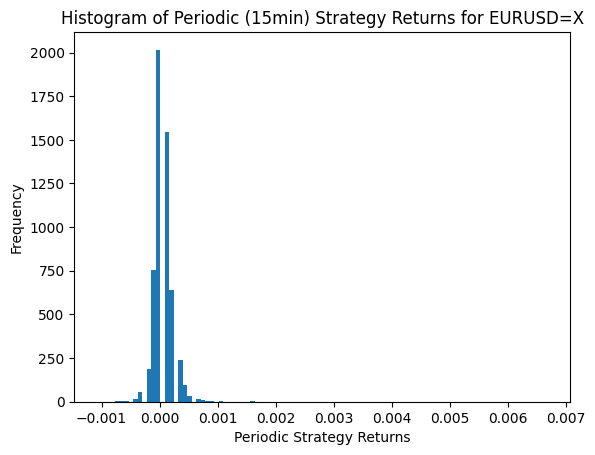

--------------------------------------------------
Total unleverage strategy return for JPY=X is 34.44%
Mean return is 0.0061%
Standard Deviation for mean return is 0.0208%
Number of positive strategy return periods (15min): 3520
Number of negative strategy return periods (15min): 1922


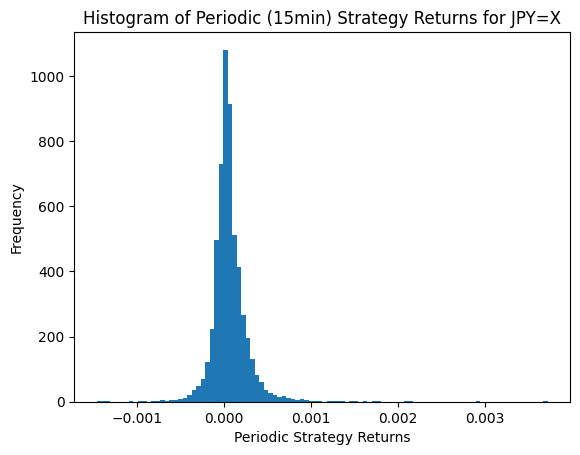

--------------------------------------------------
Total unleverage strategy return for GBPUSD=X is 36.98%
Mean return is 0.0066%
Standard Deviation for mean return is 0.0212%
Number of positive strategy return periods (15min): 3460
Number of negative strategy return periods (15min): 1880


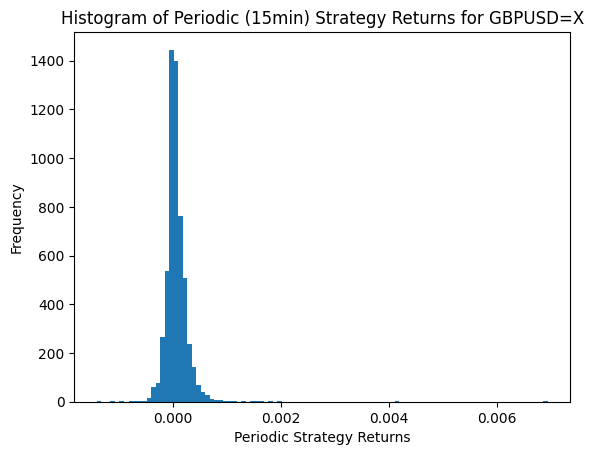

--------------------------------------------------
Total unleverage strategy return for AUDUSD=X is 52.19%
Mean return is 0.0092%
Standard Deviation for mean return is 0.0304%
Number of positive strategy return periods (15min): 3559
Number of negative strategy return periods (15min): 1883


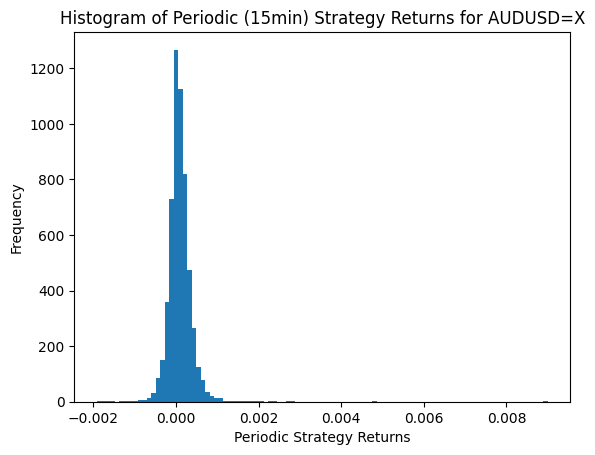

--------------------------------------------------
Total unleverage strategy return for NZDUSD=X is 52.01%
Mean return is 0.0092%
Standard Deviation for mean return is 0.0295%
Number of positive strategy return periods (15min): 3206
Number of negative strategy return periods (15min): 1582


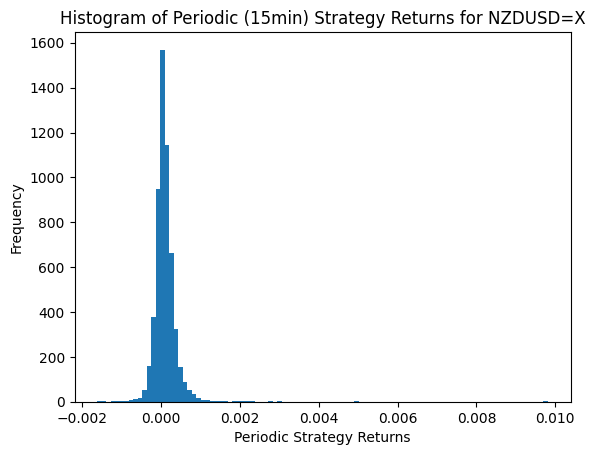

--------------------------------------------------
Total unleverage strategy return for HKD=X is 9.53%
Mean return is 0.0017%
Standard Deviation for mean return is 0.003%
Number of positive strategy return periods (15min): 3723
Number of negative strategy return periods (15min): 1411


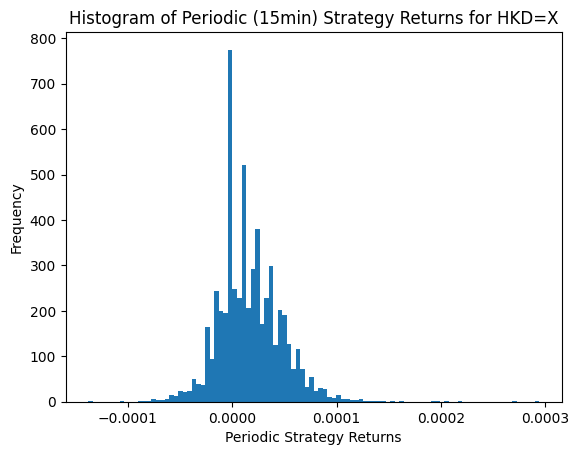

--------------------------------------------------
Total unleverage strategy return for SGD=X is 27.08%
Mean return is 0.0048%
Standard Deviation for mean return is 0.0152%
Number of positive strategy return periods (15min): 3529
Number of negative strategy return periods (15min): 1784


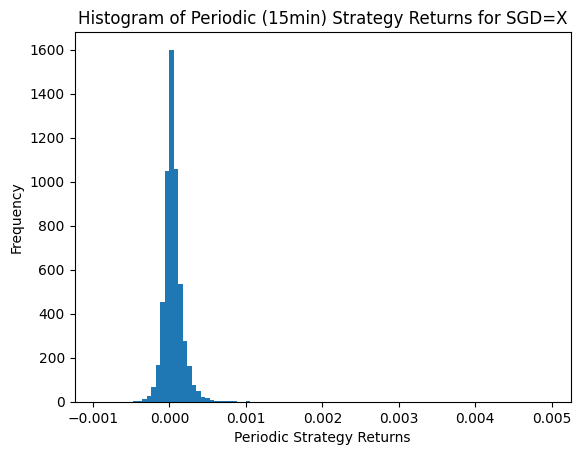

--------------------------------------------------
Total unleverage strategy return for MXN=X is 74.42%
Mean return is 0.0133%
Standard Deviation for mean return is 0.0341%
Number of positive strategy return periods (15min): 3673
Number of negative strategy return periods (15min): 1678


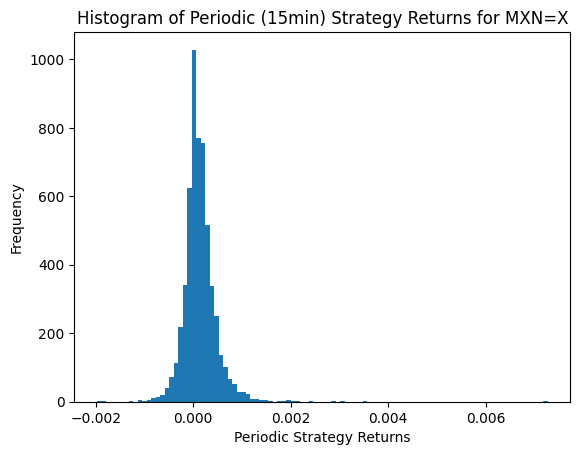

--------------------------------------------------
Total unleverage strategy return for THB=X is 81.66%
Mean return is 0.0153%
Standard Deviation for mean return is 0.0392%
Number of positive strategy return periods (15min): 2766
Number of negative strategy return periods (15min): 1130


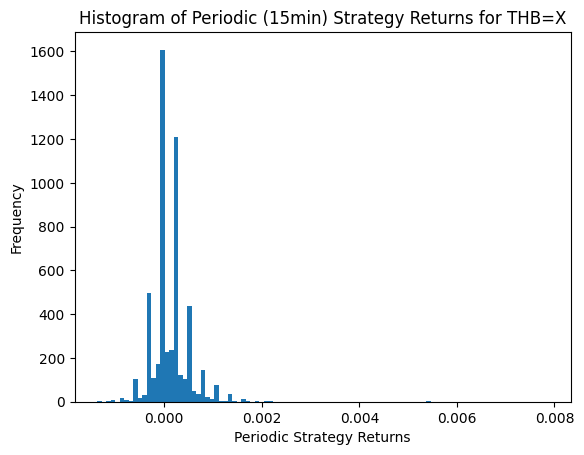

--------------------------------------------------
Total unleverage strategy return for ZAR=X is 88.86%
Mean return is 0.0158%
Standard Deviation for mean return is 0.0445%
Number of positive strategy return periods (15min): 3665
Number of negative strategy return periods (15min): 1883


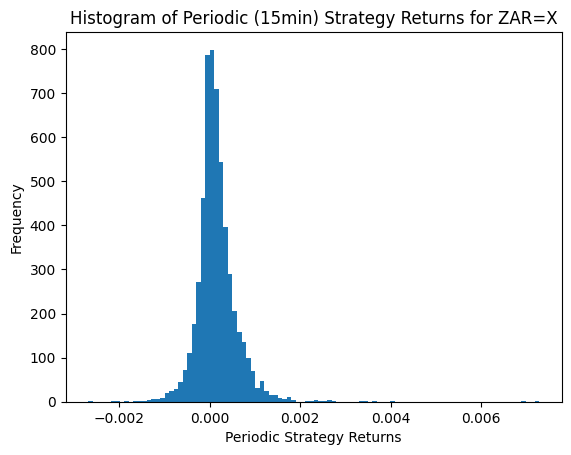

--------------------------------------------------
Total unleverage strategy return for RUB=X is 147.87%
Mean return is 0.0363%
Standard Deviation for mean return is 0.1651%
Number of positive strategy return periods (15min): 2451
Number of negative strategy return periods (15min): 1449


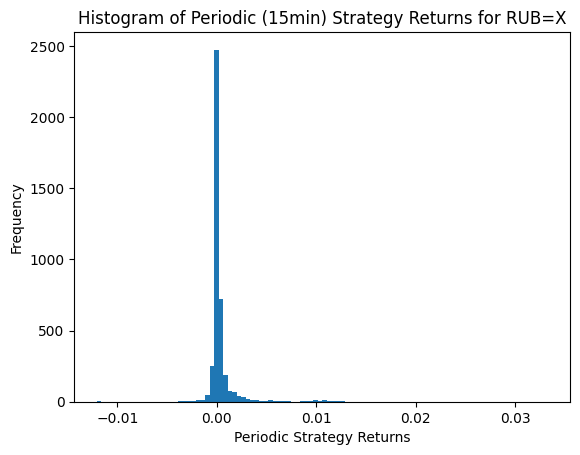

--------------------------------------------------
Total Portfolio Return: 638.89%


In [ ]:
import matplotlib.pyplot as plt

total_return = 0

for symbol in symbols:
  # assumes we buy or sell only on the next close
  #prices3[symbol]["open_returns"] = prices3[symbol]["Open"].pct_change()
  # drop all na, we dont trade if any indicator is na
  data = prices3[symbol].dropna().copy()

  # get the currency pair's model
  model = results[symbol]["best_estimator_"]

  # save the predicted y direction
  #   1 is positive => buy t+1, 0 is not positive => sell t+1
  y_pred = model.predict(data[top_8_features])
  data["signal"] = [1 if x > 0 else -1 for x in y_pred]
  # assumes we buy at around the next close period
  data["buy_on_close"] = data["signal"].shift()
  data["periodic_strategy_return"] = data["buy_on_close"] * data["Returns"]

  positive_count = len(data[data["periodic_strategy_return"] > 0])
  negative_count = len(data[data["periodic_strategy_return"] < 0])

  total_return += data["periodic_strategy_return"].sum()

  print("-" * 50)
  print("Total unleverage strategy return for {} is {}%".format(symbol, round(data["periodic_strategy_return"].sum() *100,2)))
  print("Mean return is {}%".format(round(data["periodic_strategy_return"].mean()*100,4)))
  print("Standard Deviation for mean return is {}%".format(round(data["periodic_strategy_return"].std()*100,4)))

  print(f"Number of positive strategy return periods (15min): {positive_count}")
  print(f"Number of negative strategy return periods (15min): {negative_count}")

  plt.hist(data["periodic_strategy_return"], bins=100)
  plt.title(f"Histogram of Periodic (15min) Strategy Returns for {symbol}")
  plt.xlabel("Periodic Strategy Returns")
  plt.ylabel("Frequency")
  plt.show()

print("-" * 50)
print("Total Portfolio Return: {}%".format(round(total_return*100,2)))

### 2.9 Event Based Backtesting

In [ ]:
class USD_ML_Strategy_5min(Common_Class):

  def get_top8_features(self, open, high, low, close):
    # top 8 features 'DPO_20', 'THERMO_20_2_0.5', 'SLOPE_1', 'CFO_9', 'BBB_5_2.0', 'BOP', 'BEARP_13', 'PDIST'
    dpo_df = pandas_ta.trend.dpo(close)
    thermo_df = thermo(high, low)
    slope_df = pandas_ta.momentum.slope(close)
    cfo_df = pandas_ta.momentum.cfo(close)
    bbands_df = bbands(close)
    bop_df = pandas_ta.momentum.bop(open, high, low, close)
    pdist_df = pdist(open, high, low, close)
    eri_df = pandas_ta.momentum.eri(high, low, close)

    combined = pd.concat([dpo_df, thermo_df, slope_df, bbands_df, cfo_df, bop_df, pdist_df, eri_df], axis=1)
    return combined[top_8_features].copy()

  # Compute the size of the position
  # We use simple percentage where the size is 100%/num_stocks of the available capital
  # min is 1% of available capital
  def get_pos_sizing(self, bar):
    num_stocks = len(self.symbols)
    porportion = 1 / (num_stocks + 1) # we add + 1 to stocks so that there is always some capital leftover
    if porportion < 0.01:
      porportion = 0.01

    (date, tb) = self.get_total_balance(self.symbols[0], bar)
    size = int(tb * porportion)
    return size

  def go_long(self, symbol, bar, quantity = None, dollar = None):

    if self.position[symbol] == -1:
      self.buy_order(symbol, bar, quantity = -self.quantity[symbol]) #to clear previous short position and therefore negative quantity.
    if quantity:
      self.buy_order(symbol, bar, quantity = quantity) # to create new fresh order
    elif dollar:
      if dollar == 'all':
        dollar = self.capital
      if dollar == 'equal':
        dollar = self.get_pos_sizing(bar)
      self.buy_order(symbol, bar, dollar = dollar)


  def go_short(self, symbol, bar, quantity = None, dollar = None):

    if self.position[symbol] == 1:
      self.sell_order(symbol, bar, quantity = self.quantity[symbol]) #to clear previous long vposition
    if quantity:
      self.sell_order(symbol, bar, quantity = quantity) # to create new fresh order
    elif dollar:
      if dollar == 'all':
        dollar = self.capital
      if dollar == 'equal':
        dollar = self.get_pos_sizing(bar)
      self.sell_order(symbol, bar, dollar = dollar)


  def run_strategy(self, models, models_features):
    self.trades = 0
    self.capital = self.initial_capital

    for symbol in self.symbols:
      # calculate all the top technical indicators
      top8_df3 = self.get_top8_features(self.data[symbol]["Open_Price"], self.data[symbol]["High"], self.data[symbol]["Low"], self.data[symbol]["Close_Price"])
      self.data[symbol] = pd.concat([self.data[symbol], top8_df3], axis=1)

      data = self.data[symbol]

      # get the currency pair's model
      model = models[symbol]

      # save the predicted y direction
      #   1 is positive => buy t+1, 0 is not positive => sell t+1
      y_pred = model.predict(data[models_features])
      data["signal"] = [1 if x > 0 else -1 for x in y_pred]

      # assumes we can buy at the next close
      data["buy_on_close"] = data["signal"].shift()

    # start where there is no na, we dont trade if any indicator is na
    start_bar = min(df.dropna().index.argmin() for df in self.data.values() if not df.empty)
    end_bar = max(len(df) for df in self.data.values()) - 1
    port_returns = pd.DataFrame(index=range(end_bar+1), columns=["total_balance"])

    print("start bar: ", start_bar)
    print("end bar: ", end_bar)
    for bar in range(start_bar, end_bar):
      for symbol in self.symbols:
        if bar < self.data[symbol].shape[0]:
          if self.position[symbol] in [0,-1]: # checking no position or short position
            if self.data[symbol]["buy_on_close"].iloc[bar] == 1:
              self.go_long(symbol, bar, dollar="equal") # go with equal porportion to number of stocks
              #self.position[symbol] = 1 # long created
              print("--------")

          if self.position[symbol] in [0,1]: # checking no position or long position
            if self.data[symbol]["buy_on_close"].iloc[bar] == -1:
              self.go_short(symbol, bar, dollar="equal") # go with equal porportion to number of stocks
              #self.position[symbol] = -1 # short created
              print("--------")

      # Save the balance at the end of each bar
      (date, total_balance) = self.get_total_balance(self.symbols[0], bar)
      port_returns.iloc[bar] = total_balance

    print("--------")
    self.last_trade(bar)
    print("-----------")
    print("Performance")
    print("-----------")
    # set initial capital
    port_returns.iloc[start_bar - 1] = self.initial_capital
    # compute log returns from the balances
    port_returns["log_returns"] = np.log ( 1 + port_returns["total_balance"].pct_change() )
    # get and print the performance metrics
    print(self.get_metrics(port_returns["log_returns"], "5M"))

if __name__ == "__main__":
  # Get today's date
  today = date.today()
  # Calculate start date 30 days ago
  start_date = today - timedelta(days=29)
  # Calculate start date 1 days ago
  end_date = today - timedelta(days=1)

  models = dict()
  for symbol in symbols:
    models[symbol] = results[symbol]["best_estimator_"]
  # without any transaction cost
  A = USD_ML_Strategy_5min(symbols, start_date, end_date,"5M",10000, 0, True)
  A.run_strategy(models, top_8_features)

['EURUSD=X', 'JPY=X', 'GBPUSD=X', 'AUDUSD=X', 'NZDUSD=X', 'HKD=X', 'SGD=X', 'MXN=X', 'THB=X', 'ZAR=X', 'RUB=X']
start bar:  0
end bar:  5681
Sold 760 of EURUSD=X at 1.0952 USD per EURUSD=X worth 832.33 $
Date :2024-03-14 00:10 | Realised Portfolio Balance: 10832.33
Date :2024-03-14 00:10 | Unrealised Portfolio Balance: -832.33
Date :2024-03-14 00:10 | Total Portfolio Balance: 10000.00
--------
Sold 122979 of JPY=X at 0.0068 USD per JPY=X worth 833.00 $
Date :2024-03-14 00:10 | Realised Portfolio Balance: 11665.33
Date :2024-03-14 00:10 | Unrealised Portfolio Balance: -1665.33
Date :2024-03-14 00:10 | Total Portfolio Balance: 10000.00
--------
Sold 650 of GBPUSD=X at 1.2797 USD per GBPUSD=X worth 831.80 $
Date :2024-03-14 00:10 | Realised Portfolio Balance: 12497.13
Date :2024-03-14 00:10 | Unrealised Portfolio Balance: -2497.13
Date :2024-03-14 00:10 | Total Portfolio Balance: 10000.00
--------
Sold 1257 of AUDUSD=X at 0.6626 USD per AUDUSD=X worth 832.89 $
Date :2024-03-14 00:10 | Rea

Again, for 5min interval, when spread fees is 1pip

In [ ]:
if __name__ == "__main__":
  # Get today's date
  today = date.today()
  # Calculate start date 30 days ago
  start_date = today - timedelta(days=29)
  # Calculate start date 1 days ago
  end_date = today - timedelta(days=1)

  models = dict()
  for symbol in symbols:
    models[symbol] = results[symbol]["best_estimator_"]

  # assumes spread is 1pip
  A = USD_ML_Strategy_5min(symbols, start_date, end_date,"5M",10000, 0.0001, True)
  A.run_strategy(models, top_8_features)

['EURUSD=X', 'JPY=X', 'GBPUSD=X', 'AUDUSD=X', 'NZDUSD=X', 'HKD=X', 'SGD=X', 'MXN=X', 'THB=X', 'ZAR=X', 'RUB=X']
start bar:  0
end bar:  5681
Sold 760 of EURUSD=X at 1.0952 USD per EURUSD=X worth 832.33 $
Date :2024-03-14 00:10 | Realised Portfolio Balance: 10832.25
Date :2024-03-14 00:10 | Unrealised Portfolio Balance: -832.33
Date :2024-03-14 00:10 | Total Portfolio Balance: 9999.92
--------
Sold 122966 of JPY=X at 0.0068 USD per JPY=X worth 832.91 $
Date :2024-03-14 00:10 | Realised Portfolio Balance: 11665.07
Date :2024-03-14 00:10 | Unrealised Portfolio Balance: -1665.24
Date :2024-03-14 00:10 | Total Portfolio Balance: 9999.83
--------
Sold 650 of GBPUSD=X at 1.2797 USD per GBPUSD=X worth 831.80 $
Date :2024-03-14 00:10 | Realised Portfolio Balance: 12496.79
Date :2024-03-14 00:10 | Unrealised Portfolio Balance: -2497.04
Date :2024-03-14 00:10 | Total Portfolio Balance: 9999.75
--------
Sold 1257 of AUDUSD=X at 0.6626 USD per AUDUSD=X worth 832.89 $
Date :2024-03-14 00:10 | Realis

Due to the spread of 1pip we made only 1% giving up 30% of our returns to spread fees over a 1month period

We could again increase our trading interval to 15mins and try again.
In addition, we should try to simulate buying on the next bar's open price.
This would be more realistic and similar to live trading as especially for large intervals of 15mins or 1hour.

# 3. Repeat for 15mins interval

### 3.1 Preparing the data
- For symbols in the format: "ABC=X", the price will be inverted (1/price) to get the actual USD price per ABC currency
- returns will be computed using closing price
- returns_1 will be computed too, which is the next day close price return (t+1) for model prediction

In [ ]:
# symbols = ["EURUSD=X", "JPY=X", "GBPUSD=X", "AUDUSD=X", "NZDUSD=X","CNY=X","HKD=X","SGD=X","INR=X","MXN=X","PHP=X","IDR=X","THB=X", "MYR=X","ZAR=X","RUB=X"]
# Drop CNY=X, INR=X, PHP=X, IDR=X, MYR=X
# they have very irregular time intervals of non 15 mins interval
# model will not be able to learn well
symbols = ["EURUSD=X", "JPY=X", "GBPUSD=X", "AUDUSD=X", "NZDUSD=X","HKD=X","SGD=X","MXN=X","THB=X","ZAR=X","RUB=X"]
prices = dict()

from datetime import date, timedelta
# We can only download 60 days ago
# we use first 45days data to select technical indicators and fine tune our model
# then we use the closest 15days data to test our model profitability
# Get today's date
today = date.today()
# Calculate start date 60 days ago
start_date = today - timedelta(days=59)
# Calculate end date 315 days ago
end_date = today - timedelta(days=15)

# Fetch historical data
for symbol in symbols:
  data = yf.Ticker(symbol)

  prices[symbol] = data.history(start=start_date, end=end_date, interval = '15M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices[symbol] = 1 / prices[symbol]

  prices[symbol]["Returns"] = prices[symbol]["Close"].pct_change()
  prices[symbol]["Returns_1"] = prices[symbol]["Returns"].shift(-1)

In [ ]:
prices

{'EURUSD=X':                                Open      High       Low     Close   Returns  \
 Datetime                                                                      
 2024-02-13 00:00:00+00:00  1.077470  1.077586  1.077238  1.077354       NaN   
 2024-02-13 00:15:00+00:00  1.077354  1.077354  1.077006  1.077006 -0.000323   
 2024-02-13 00:30:00+00:00  1.077006  1.077122  1.077006  1.077006  0.000000   
 2024-02-13 00:45:00+00:00  1.077122  1.077586  1.077006  1.077586  0.000539   
 2024-02-13 01:00:00+00:00  1.077702  1.077702  1.077354  1.077354 -0.000216   
 ...                             ...       ...       ...       ...       ...   
 2024-03-27 22:45:00+00:00  1.081900  1.081900  1.081315  1.081549 -0.000216   
 2024-03-27 23:00:00+00:00  1.081666  1.081666  1.081432  1.081549  0.000000   
 2024-03-27 23:15:00+00:00  1.081549  1.081783  1.081549  1.081666  0.000108   
 2024-03-27 23:30:00+00:00  1.081666  1.081783  1.081549  1.081549 -0.000108   
 2024-03-27 23:45:00+00:00  

### 3.2 Computing all the 181 technical indicators for each selected currency pair

In [ ]:
for symbol in symbols:
  entropy_df = pandas_ta.statistics.entropy(prices[symbol]["Close"])
  kurtosis_df = pandas_ta.statistics.kurtosis(prices[symbol]["Close"])
  mad_df = pandas_ta.statistics.mad(prices[symbol]["Close"])
  median_df = pandas_ta.statistics.median(prices[symbol]["Close"])
  skew_df = pandas_ta.statistics.skew(prices[symbol]["Close"])
  stdev_df = pandas_ta.statistics.stdev(prices[symbol]["Close"])
  tosstdev_df = pandas_ta.statistics.tos_stdevall(prices[symbol]["Close"])
  var_df = pandas_ta.statistics.variance(prices[symbol]["Close"])
  zscore_df = pandas_ta.statistics.zscore(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], entropy_df, kurtosis_df, mad_df, median_df, skew_df, stdev_df, tosstdev_df, var_df, zscore_df], axis=1)

  alma_df = pandas_ta.overlap.alma(prices[symbol]["Close"])
  dema_df = pandas_ta.overlap.dema(prices[symbol]["Close"])
  ema_df = pandas_ta.overlap.ema(prices[symbol]["Close"])
  fwma_df = pandas_ta.overlap.fwma(prices[symbol]["Close"])
  hilo_df = pandas_ta.overlap.hilo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  hl2_df = pandas_ta.overlap.hl2(prices[symbol]["High"], prices[symbol]["Low"])
  hlc3_df = pandas_ta.overlap.hlc3(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  hma_df = pandas_ta.overlap.hma(prices[symbol]["Close"])
  hwma_df = pandas_ta.overlap.hwma(prices[symbol]["Close"])
  ichimoku_df = pandas_ta.overlap.ichimoku(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  jma_df = pandas_ta.overlap.jma(prices[symbol]["Close"])
  kama_df = pandas_ta.overlap.kama(prices[symbol]["Close"])
  linreg_df = pandas_ta.overlap.linreg(prices[symbol]["Close"])
  mcgd_df = pandas_ta.overlap.mcgd(prices[symbol]["Close"])
  midpoint_df = pandas_ta.overlap.midpoint(prices[symbol]["Close"])
  midprice_df = pandas_ta.overlap.midprice(prices[symbol]["High"], prices[symbol]["Low"])
  ohlc4_df = pandas_ta.overlap.ohlc4(prices[symbol]["Open"],prices[symbol]["High"], prices[symbol]["Low"],prices[symbol]["Close"])
  pwma_df = pandas_ta.overlap.pwma(prices[symbol]["Close"])
  rma_df = pandas_ta.overlap.rma(prices[symbol]["Close"])
  sinwma_df = pandas_ta.overlap.sinwma(prices[symbol]["Close"])
  sma_df = pandas_ta.overlap.sma(prices[symbol]["Close"])
  ssf_df = pandas_ta.overlap.ssf(prices[symbol]["Close"])
  supertrend_df = pandas_ta.overlap.supertrend(prices[symbol]["High"], prices[symbol]["Low"],prices[symbol]["Close"])
  swma_df = pandas_ta.overlap.swma(prices[symbol]["Close"])
  t3_df = pandas_ta.overlap.t3(prices[symbol]["Close"])
  tema_df = pandas_ta.overlap.tema(prices[symbol]["Close"])
  trima_df = pandas_ta.overlap.trima(prices[symbol]["Close"])
  vidya_df = pandas_ta.overlap.vidya(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], alma_df, dema_df, ema_df, fwma_df, hilo_df, hl2_df, hlc3_df, hma_df, hwma_df, ichimoku_df[0], jma_df, kama_df, linreg_df, mcgd_df, midpoint_df, midprice_df, ohlc4_df, pwma_df, rma_df, sinwma_df, sma_df, ssf_df, supertrend_df, swma_df, t3_df, tema_df, trima_df, vidya_df], axis=1)

  adx_df = pandas_ta.trend.adx(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  aroon_df = pandas_ta.trend.aroon(prices[symbol]["High"], prices[symbol]["Low"])
  chop_df = pandas_ta.trend.chop(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cksp_df = pandas_ta.trend.cksp(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  decay_df = pandas_ta.trend.decay(prices[symbol]["Close"])
  decreasing_df = pandas_ta.trend.decreasing(prices[symbol]["Close"])
  dpo_df = pandas_ta.trend.dpo(prices[symbol]["Close"])
  increasing_df = pandas_ta.trend.increasing(prices[symbol]["Close"])
  psar_df = pandas_ta.trend.psar(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  qstick_df = pandas_ta.trend.qstick(prices[symbol]["Open"], prices[symbol]["Close"])
  ttm_df = pandas_ta.trend.ttm_trend(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  vhf_df = pandas_ta.trend.vhf(prices[symbol]["Close"])
  vortex_df = pandas_ta.trend.vortex(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], adx_df, aroon_df, chop_df, cksp_df, dpo_df, decay_df, decreasing_df, increasing_df, psar_df, qstick_df, ttm_df, vhf_df, vortex_df], axis=1)

  ao_df = pandas_ta.momentum.ao(prices[symbol]["High"], prices[symbol]["Low"])
  apo_df = pandas_ta.momentum.apo(prices[symbol]["Close"])
  bias_df = pandas_ta.momentum.bias(prices[symbol]["Close"])
  bop_df = pandas_ta.momentum.bop(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  brar_df = pandas_ta.momentum.brar(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cci_df = pandas_ta.momentum.cci(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  cfo_df = pandas_ta.momentum.cfo(prices[symbol]["Close"])
  cg_df = pandas_ta.momentum.cg(prices[symbol]["Close"])
  cmo_df = pandas_ta.momentum.cmo(prices[symbol]["Close"])
  coppock_df = pandas_ta.momentum.coppock(prices[symbol]["Close"])
  cti_df = pandas_ta.momentum.cti(prices[symbol]["Close"])
  dm_df = pandas_ta.momentum.dm(prices[symbol]["High"], prices[symbol]["Low"])
  er_df = pandas_ta.momentum.er(prices[symbol]["Close"])
  eri_df = pandas_ta.momentum.eri(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  fisher_df = pandas_ta.momentum.fisher(prices[symbol]["High"], prices[symbol]["Low"])
  kdj_df = pandas_ta.momentum.kdj(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  kst_df = pandas_ta.momentum.kst(prices[symbol]["Close"])
  macd_df = pandas_ta.momentum.macd(prices[symbol]["Close"])
  mom_df = pandas_ta.momentum.mom(prices[symbol]["Close"])
  pgo_df = pandas_ta.momentum.pgo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ppo_df = pandas_ta.momentum.ppo(prices[symbol]["Close"])
  psl_df = pandas_ta.momentum.psl(prices[symbol]["Close"])
  #pvo_df = pandas_ta.momentum.pvo(prices[symbol]["Volume"]) #no volume data`
  qqe_df = pandas_ta.momentum.qqe(prices[symbol]["Close"])
  roc_df = pandas_ta.momentum.roc(prices[symbol]["Close"])
  rsi_df = pandas_ta.momentum.rsi(prices[symbol]["Close"])
  rsx_df = pandas_ta.momentum.rsx(prices[symbol]["Close"])
  rvgi_df = pandas_ta.momentum.rvgi(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  slope_df = pandas_ta.momentum.slope(prices[symbol]["Close"])
  smi_df = pandas_ta.momentum.smi(prices[symbol]["Close"])
  squeeze_df = pandas_ta.momentum.squeeze(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  squeezepro_df = pandas_ta.momentum.squeeze_pro(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  stc_df = pandas_ta.momentum.stc(prices[symbol]["Close"])
  stoch_df = pandas_ta.momentum.stoch(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  stochrsi_df = pandas_ta.momentum.stochrsi(prices[symbol]["Close"])
  #tdseq_df = pandas_ta.momentum.td_seq(prices[symbol]["Close"]) #this cause the dataframe to go crazy when concat
  trix_df = pandas_ta.momentum.trix(prices[symbol]["Close"])
  tsi_df = pandas_ta.momentum.tsi(prices[symbol]["Close"])
  uo_df = pandas_ta.momentum.uo(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  willr_df = pandas_ta.momentum.willr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], ao_df, apo_df, bias_df, bop_df, brar_df, cci_df, cfo_df, cg_df, cmo_df, coppock_df, cti_df, dm_df, er_df, eri_df, fisher_df, kdj_df, kst_df, macd_df, mom_df, pgo_df, ppo_df, psl_df, qqe_df, roc_df, rsi_df, rsx_df, rvgi_df, slope_df, smi_df, squeeze_df, squeezepro_df, stc_df, stoch_df, stochrsi_df, trix_df, tsi_df, uo_df, willr_df], axis=1)

  aberration_df = aberration(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  accbands_df = accbands(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  atr_df = atr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  bbands_df = bbands(prices[symbol]["Close"])
  donchian_df = donchian(prices[symbol]["High"], prices[symbol]["Low"])
  hwc_df = hwc(prices[symbol]["Close"])
  kc_df = kc(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  massi_df = massi(prices[symbol]["High"], prices[symbol]["Low"])
  natr_df = natr(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  pdist_df = pdist(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  rvi_df = rvi(prices[symbol]["Close"], prices[symbol]["High"], prices[symbol]["Low"])
  thermo_df = thermo(prices[symbol]["High"], prices[symbol]["Low"])
  truerange_df = true_range(prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ui_df = ui(prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], aberration_df, accbands_df, atr_df, bbands_df, donchian_df, hwc_df, kc_df, massi_df, natr_df, pdist_df, rvi_df, thermo_df, ui_df, truerange_df], axis=1)

  doji_df = pandas_ta.candles.cdl_doji(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  inside_df = pandas_ta.candles.cdl_inside(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  z_df = pandas_ta.candles.cdl_z(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])
  ha_df = pandas_ta.candles.ha(prices[symbol]["Open"], prices[symbol]["High"], prices[symbol]["Low"], prices[symbol]["Close"])

  prices[symbol] = pd.concat([prices[symbol], doji_df, inside_df, z_df, ha_df], axis=1)

Drop duplicated columns. We ignore them

In [ ]:
for symbol in symbols:
  prices[symbol] = prices[symbol].drop(columns=["DMP_14", "DMN_14"]) #drop duplicates

### 3.3 First Initial Machine Learning
- First run to select the top 15 indicators to use

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

today = date.today()
# We have 45 days of data starting from 60 days ago
# We cutoff 30 days from today, and we have 30 days of training data and 15 days if validation data
cutoff_date = str(today - timedelta(days=30))
print("Training and Testing data Cut off Date: ", cutoff_date)

results = {}
average_accuracy = 0

for symbol in symbols:
  # Drop na for returns(t+1)
  data = prices[symbol].dropna(subset=["Returns_1"])

  # Split train data and test data, before and after 2 Apr 2024 respectively
  train_data = data.loc[data.index <= cutoff_date] # around 20 days of train data
  test_data = data.loc[data.index > cutoff_date] # 10 days of validation data

  # Get X and y
  X_train = train_data.drop(columns=["Returns", "Returns_1"], axis=1)
  y_train = train_data["Returns_1"]
  X_test = test_data.drop(columns=["Returns", "Returns_1"], axis=1)
  y_test = test_data["Returns_1"]

  model = lgb.LGBMRegressor(n_estimators=200, learning_rate=0.1, random_state=42)

  param_grid = {
      'n_estimators': [200],
      'learning_rate': [0.1],
      #'max_depth': range(2, 6),
      'num_leaves': [30],
      'verbose': [-1]
  }

  # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
  grid_search.fit(X_train, y_train)

  # Best model
  best_params = grid_search.best_params_
  best_score = grid_search.best_score_
  print("\nScore and Feature Importance for ", symbol)
  print(f"Best parameters: {best_params}")
  print(f"Best validation R-squared score: {best_score}")

  best_model = grid_search.best_estimator_

  # Make predictions on the test set
  y_pred = best_model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5

  print("RMSE:", rmse)

  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Price Direction Accuracy:", accuracy)

  average_accuracy += accuracy

  # Get the feature importance
  importances = best_model.feature_importances_

  # Create a dataframe with feature importance
  feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

  results[symbol] = {
      "best_estimator_": best_model,
      "best_params": best_params,
      "best_score": best_score,
      "rmse": rmse,
      "accuracy": accuracy
  }

  # Sort the dataframe by importance
  feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  # Print the top 15 most important features
  print(feature_importance_df.head(15))

print("Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))

Training and Testing data Cut off Date:  2024-03-13

Score and Feature Importance for  EURUSD=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'num_leaves': 30, 'verbose': -1}
Best validation R-squared score: -4.285939281067391
RMSE: 0.0002735599004025312
Price Direction Accuracy: 0.6377649325626205
             feature  importance
63            DPO_20         417
168           RVI_14         207
179       low_Z_30_1         139
83             CFO_9         139
167            PDIST         137
169  THERMO_20_2_0.5         124
141       UO_7_14_28         116
34            ICS_26         109
71             QS_10         108
174      TRUERANGE_1         107
165       MASSI_9_25         107
154        BBB_5_2.0         105
73            VHF_28          99
119      SMIo_5_20_5          97
88             ER_10          92

Score and Feature Importance for  JPY=X
Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'num_leaves': 30, 'verbose': -1}
Best validation R-squa

In [ ]:
feature_importances = pd.DataFrame(index=prices[symbol].drop(columns=["Returns", "Returns_1"], axis=1).columns)
for symbol in symbols:
  feature_importances[symbol] = results[symbol]["best_estimator_"].feature_importances_

feature_importances["sum"] = feature_importances.sum(axis=1)
feature_importances.sort_values(by="sum", ascending=False).head(15)

,EURUSD=X,JPY=X,GBPUSD=X,AUDUSD=X,NZDUSD=X,HKD=X,SGD=X,MXN=X,THB=X,ZAR=X,RUB=X,sum
DPO_20,417,431,314,464,460,234,367,429,416,545,372,4449
THERMO_20_2_0.5,124,131,133,158,150,112,173,109,176,226,188,1680
CFO_9,139,144,78,113,104,106,132,120,79,147,157,1319
TRUERANGE_1,107,150,88,98,123,104,158,107,101,90,171,1297
PDIST,137,149,129,118,114,90,173,117,84,91,81,1283
BBB_5_2.0,105,100,80,103,102,116,91,149,121,103,102,1172
RVI_14,207,144,93,78,116,96,90,97,94,77,41,1133
SLOPE_1,70,96,108,115,124,98,102,101,84,123,94,1115
BULLP_13,79,74,92,81,81,143,82,130,143,104,100,1109
BOP,92,82,87,118,108,115,70,87,89,112,72,1032


In [ ]:
selected_features = feature_importances.sort_values(by="sum", ascending=False).head(15).index
selected_features

Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', 'TRUERANGE_1', 'PDIST',
       'BBB_5_2.0', 'RVI_14', 'SLOPE_1', 'BULLP_13', 'BOP', 'CCI_14_0.015',
       'ER_10', 'BEARP_13', 'BBP_5_2.0', 'KURT_30'],
      dtype='object')

### 3.4 Iterate the machine learning algo for the top15 indicators, dropping 1 indicators each run and see its performance (accuracy of price direction)

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

today = date.today()
# We have 45 days of data starting from 60 days ago
# We cutoff 30 days from today, and we have 30 days of training data and 15 days if validation data
cutoff_date = str(today - timedelta(days=30))
print("Training and Testing data Cut off Date: ", cutoff_date)

results_iterate = {}
average_accuracy = 0
selected_features_scores = pd.DataFrame()

# keep iterating and removing 1 least important feature until we selected 2 most important feature
while len(selected_features) > 2:
  average_accuracy = 0
  for symbol in symbols:
    # Drop na for returns(t+1)
    data = prices[symbol].dropna(subset=["Returns_1"])

    # Split train data and test data, before and after 2 Apr 2024 respectively
    train_data = data.loc[data.index <= cutoff_date] # 3 days of train data
    test_data = data.loc[data.index > cutoff_date] # 2 days of test data

    # Get X and y
    X_train = train_data[selected_features]
    y_train = train_data["Returns_1"]
    X_test = test_data[selected_features]
    y_test = test_data["Returns_1"]

    model = lgb.LGBMRegressor(n_estimators=200, learning_rate=0.1, random_state=42)

    param_grid = {
        'n_estimators': [200],
        'learning_rate': [0.1],
        #'max_depth': range(2, 6),
        'num_leaves': [30],
        'verbose': [-1]
    }

    # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
    grid_search.fit(X_train, y_train)

    best_model = grid_search.best_estimator_

    # Make predictions on the test set
    y_pred = best_model.predict(X_test)

    y_test_binary = [1 if x > 0 else 0 for x in y_test]
    y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

    accuracy = accuracy_score(y_test_binary, y_pred_binary)
    print("Price Direction Test Accuracy for {}: {}".format(symbol,accuracy))

    average_accuracy += accuracy

    # Get the feature importance
    importances = best_model.feature_importances_

    # Create a dataframe with feature importance
    feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

    # Sort the dataframe by importance
    feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  print("Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))
  feature_accuracy = pd.DataFrame({
      'features': [selected_features],
      'accuracy': [average_accuracy/len(symbols)]
  })
  selected_features_scores = pd.concat([selected_features_scores,feature_accuracy], ignore_index=True)

  # get the top features
  feature_importances = pd.DataFrame(index=prices[symbol].drop(columns=["Returns", "Returns_1"], axis=1).columns)
  for symbol in symbols:
    feature_importances[symbol] = results[symbol]["best_estimator_"].feature_importances_

  feature_importances["sum"] = feature_importances.sum(axis=1)
  sorted_importances = feature_importances.sort_values(by="sum", ascending=False)
  dropped_feature = sorted_importances.tail(1).index[0]
  # Select new feature by dropping the lowest importance
  selected_features = sorted_importances.head(len(selected_features) - 1).index
  print("-" * 30)
  print("Selected {} features".format(len(selected_features)))
  print("Selected: ", selected_features)
  print("Dropped: ", dropped_feature)

Training and Testing data Cut off Date:  2024-03-13


Price Direction Test Accuracy for EURUSD=X: 0.5992292870905588
Price Direction Test Accuracy for JPY=X: 0.625242718446602
Price Direction Test Accuracy for GBPUSD=X: 0.6083172147001934
Price Direction Test Accuracy for AUDUSD=X: 0.6007677543186181
Price Direction Test Accuracy for NZDUSD=X: 0.6180422264875239
Price Direction Test Accuracy for HKD=X: 0.6612127045235804
Price Direction Test Accuracy for SGD=X: 0.5780346820809249
Price Direction Test Accuracy for MXN=X: 0.6315280464216635
Price Direction Test Accuracy for THB=X: 0.6370808678500987
Price Direction Test Accuracy for ZAR=X: 0.602502406159769
Price Direction Test Accuracy for RUB=X: 0.6264236902050114
Average Price Direction Test Accuracy:  0.6171255998440495
------------------------------
Selected 14 features
Selected:  Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', 'TRUERANGE_1', 'PDIST',
       'BBB_5_2.0', 'RVI_14', 'SLOPE_1', 'BULLP_13', 'BOP', 'CCI_14_0.015',
       'ER_10', 'BEARP_13', 'BBP_5_2.0'],
      dtype='object')

In [ ]:
selected_features_scores.set_index(selected_features_scores['features'].apply(len), inplace=True)
selected_features_scores

,features,accuracy
features,,
15,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.617126
14,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.617390
13,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.620424
12,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.619118
11,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.616253
10,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.620698
9,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.618473
8,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.602607
7,"Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', '...",0.603971


Accuracy drops when features less than 10

In [ ]:
top_10_features = selected_features_scores.loc[10,"features"]
top_10_features

Index(['DPO_20', 'THERMO_20_2_0.5', 'CFO_9', 'TRUERANGE_1', 'PDIST',
       'BBB_5_2.0', 'RVI_14', 'SLOPE_1', 'BULLP_13', 'BOP'],
      dtype='object')

### 3.5 Built the data again only for the selected top 10 indicators

In [ ]:
from pandas_ta.volatility import bbands, rvi

def get_top10_features(open, high, low, close):
  # top 10 features 'DPO_20', 'THERMO_20_2_0.5', 'CFO_9', 'TRUERANGE_1', 'PDIST', 'BBB_5_2.0', 'RVI_14', 'SLOPE_1', 'BULLP_13', 'BOP'
  dpo_df = pandas_ta.trend.dpo(close)
  thermo_df = thermo(high, low)
  cfo_df = pandas_ta.momentum.cfo(close)
  truerange_df = true_range(high, low, close)
  pdist_df = pdist(open, high, low, close)
  bbands_df = bbands(close)
  #cci_df = pandas_ta.momentum.cci(high, low, close)
  rvi_df = rvi(close, high, low)
  slope_df = pandas_ta.momentum.slope(close)
  eri_df = pandas_ta.momentum.eri(high, low, close)
  bop_df = pandas_ta.momentum.bop(open, high, low, close)

  combined = pd.concat([dpo_df, thermo_df, slope_df, cfo_df, truerange_df, bbands_df, rvi_df, pdist_df, eri_df, bop_df], axis=1)
  return combined[top_10_features].copy()

prices2 = dict()

# Fetch historical data
for symbol in symbols:

  prices2[symbol] = yf.Ticker(symbol).history(start=start_date, end=end_date, interval = '5M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices2[symbol] = 1 / prices2[symbol]

  top10_df = get_top10_features(prices2[symbol]["Open"], prices2[symbol]["High"], prices2[symbol]["Low"], prices2[symbol]["Close"])
  prices2[symbol] = pd.concat([prices2[symbol], top10_df], axis=1)
  prices2[symbol]["Returns"] = prices[symbol]["Close"].pct_change()
  prices2[symbol]["Returns_1"] = prices[symbol]["Returns"].shift(-1)

### 3.6 Train and fine tune the models again using the selected top features

In [ ]:
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, accuracy_score

today = date.today()
# We have 45 days of data starting from 60 days ago
# We cutoff 30 days from today, and we have 30 days of training data and 15 days if validation data
cutoff_date = str(today - timedelta(days=30))
print("Training and Testing data Cut off Date: ", cutoff_date)

results = {}
average_accuracy = 0

for symbol in symbols:
  # Drop na for returns(t+1)
  data = prices2[symbol].dropna(subset=["Returns_1"])

  # Split train data and test data, before and after 2 Apr 2024 respectively
  train_data = data.loc[data.index <= cutoff_date] # 3 days of train data
  test_data = data.loc[data.index > cutoff_date] # 2 days of test data

  # Get X and y
  X_train = train_data[top_10_features]
  y_train = train_data["Returns_1"]
  X_test = test_data[top_10_features]
  y_test = test_data["Returns_1"]

  model = lgb.LGBMRegressor(random_state=42)

  param_grid = {
      'n_estimators': range(10,100,5),
      'learning_rate': [0.05,0.06, 0.07,0.08, 0.09,0.1],
      #'max_depth': range(2, 6),
      'num_leaves': [5, 10,15,20,30],
      'verbose': [-1]
  }

  # GridSearchCV with TimeSeriesSplit (Expanding window, with each 5 window period)
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=TimeSeriesSplit(n_splits=4).split(X_train), n_jobs=-1, verbose=0)
  grid_search.fit(X_train, y_train)

  # Best model
  best_params = grid_search.best_params_
  best_score = grid_search.best_score_
  print("\nScore for", symbol)
  print(f"Best parameters: {best_params}")
  print(f"Best validation R-squared score: {best_score}")

  best_model = grid_search.best_estimator_

  # Make predictions on the test set
  y_pred = best_model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5

  print("RMSE:", rmse)

  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Test Price Direction Accuracy:", accuracy)

  average_accuracy += accuracy

  # Get the feature importance
  #importances = best_model.feature_importances_

  # Create a dataframe with feature importance
  #feature_importance_df = pd.DataFrame({"feature": X_train.columns, "importance": importances})

  results[symbol] = {
      "best_estimator_": best_model,
      "best_params": best_params,
      "best_score": best_score,
      "rmse": rmse,
      "accuracy": accuracy
  }

  # Sort the dataframe by importance
  #feature_importance_df = feature_importance_df.sort_values(by="importance", ascending=False)

  # Print the top 15 most important features
  #print(feature_importance_df.head(15))

print("Overall Average Price Direction Test Accuracy: ", average_accuracy/len(symbols))

Training and Testing data Cut off Date:  2024-03-13

Score for EURUSD=X
Best parameters: {'learning_rate': 0.07, 'n_estimators': 30, 'num_leaves': 10, 'verbose': -1}
Best validation R-squared score: 0.2611770800938461
RMSE: 0.0002416394056579414
Test Price Direction Accuracy: 0.6348747591522158

Score for JPY=X
Best parameters: {'learning_rate': 0.08, 'n_estimators': 60, 'num_leaves': 5, 'verbose': -1}
Best validation R-squared score: 0.23677647688078157
RMSE: 0.0003579073278202526
Test Price Direction Accuracy: 0.6669902912621359

Score for GBPUSD=X
Best parameters: {'learning_rate': 0.08, 'n_estimators': 25, 'num_leaves': 10, 'verbose': -1}
Best validation R-squared score: 0.28454799859948876
RMSE: 0.0002748563061936392
Test Price Direction Accuracy: 0.6682785299806576

Score for AUDUSD=X
Best parameters: {'learning_rate': 0.08, 'n_estimators': 40, 'num_leaves': 5, 'verbose': -1}
Best validation R-squared score: 0.24319337425509088
RMSE: 0.0003948907237178878
Test Price Direction Acc

Now we test the model. First by checking the accuracy of the model against out of sample test data

### 3.7 Prepare the out of sample test data (from today to 14days ago) for evaluation. Run the models. First we compute the test accuracy

In [ ]:
# we use the closest 15days data to test our model profitability
# Get today's date
today = date.today()
# Calculate start date 14 days ago
start_date = today - timedelta(days=14)
# Calculate end date 1 days ago
end_date = today - timedelta(days=1)

prices3 = dict()

for symbol in symbols:
  prices3[symbol] = yf.Ticker(symbol).history(start=start_date, end=end_date, interval = '15M').drop(columns=["Volume","Dividends","Stock Splits"])

  # if the symbol is "ABC=X", we need to invert to price to get the usd price per ABC currency
  # if the symbol is "ABCUSD=X", then the price is already in usd price per ABC currency
  if len(symbol) == 5:
    prices3[symbol] = 1 / prices3[symbol]

  top10_df3 = get_top10_features(prices3[symbol]["Open"], prices3[symbol]["High"], prices3[symbol]["Low"], prices3[symbol]["Close"])
  prices3[symbol] = pd.concat([prices3[symbol], top10_df3], axis=1)
  prices3[symbol]["Returns"] = prices3[symbol]["Close"].pct_change()
  prices3[symbol]["Returns_1"] = prices3[symbol]["Returns"].shift(-1)
  prices3[symbol]["Returns_1"] = prices3[symbol]["Returns_1"].fillna(0) # fill the last cell with 0 since we do not have returns t+1 for last row

  model = results[symbol]["best_estimator_"]

  data = prices3[symbol].dropna(subset=['Returns_1'])
  X_test = data[top_10_features]
  y_test = data["Returns_1"]

  y_pred = model.predict(X_test)

  # Calculate the RMSE
  mse = mean_squared_error(y_test, y_pred)
  rmse = mse ** 0.5
  print("-" * 20)
  print("For", symbol, ':')
  print("RMSE:", rmse)

  # Calculate the accuracy
  y_test_binary = [1 if x > 0 else 0 for x in y_test]
  y_pred_binary = [1 if x > 0 else 0 for x in y_pred]

  prices3[symbol]["signal"] = [1 if x > 0 else -1 for x in y_pred]
  prices3[symbol]["signal_test"] = [1 if x > 0 else -1 for x in y_test]
  prices3[symbol]["buy_on_close"] = prices3[symbol]["signal"].shift()
  prices3[symbol]["periodic_strategy_return"] = prices3[symbol]["buy_on_close"] * prices3[symbol]["Returns"]

  positive_count = len(prices3[symbol][prices3[symbol]["periodic_strategy_return"] > 0])
  negative_count = len(prices3[symbol][prices3[symbol]["periodic_strategy_return"] < 0])

  print(f"Number of positive strategy return periods (min): {positive_count}")
  print(f"Number of negative strategy return periods (min): {negative_count}")

  accuracy = accuracy_score(y_test_binary, y_pred_binary)
  print("Out of Sample Price Direction Accuracy:", accuracy)

--------------------
For EURUSD=X :
RMSE: 0.0004004591493704323
Number of positive strategy return periods (min): 440
Number of negative strategy return periods (min): 221
Out of Sample Price Direction Accuracy: 0.6061320754716981
--------------------
For JPY=X :
RMSE: 0.00030769158465973254
Number of positive strategy return periods (min): 508
Number of negative strategy return periods (min): 321
Out of Sample Price Direction Accuracy: 0.6113074204946997
--------------------
For GBPUSD=X :
RMSE: 0.0004438734252253825
Number of positive strategy return periods (min): 526
Number of negative strategy return periods (min): 299
Out of Sample Price Direction Accuracy: 0.6308962264150944
--------------------
For AUDUSD=X :
RMSE: 0.0006170289269414188
Number of positive strategy return periods (min): 550
Number of negative strategy return periods (min): 284
Out of Sample Price Direction Accuracy: 0.6525821596244131
--------------------
For NZDUSD=X :
RMSE: 0.0006146370841427283
Number of posi

### 3.8 Quick Vectorized Backtesting results

--------------------------------------------------
Total unleverage strategy return for EURUSD=X is 7.6%
Mean return is 0.0092%
Standard Deviation for mean return is 0.04%
Number of positive strategy return periods (15min): 430
Number of negative strategy return periods (15min): 213


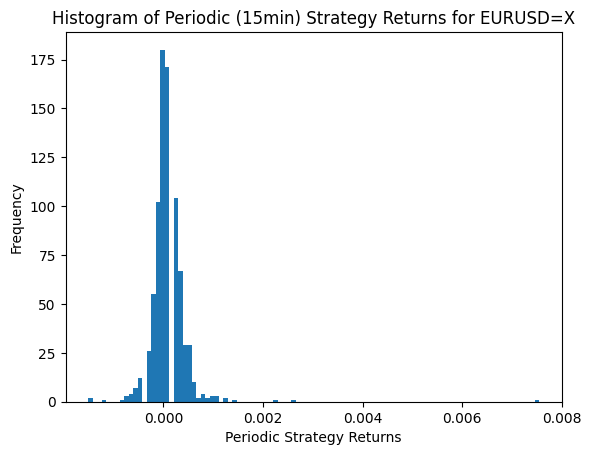

--------------------------------------------------
Total unleverage strategy return for JPY=X is 6.31%
Mean return is 0.0077%
Standard Deviation for mean return is 0.0282%
Number of positive strategy return periods (15min): 495
Number of negative strategy return periods (15min): 312


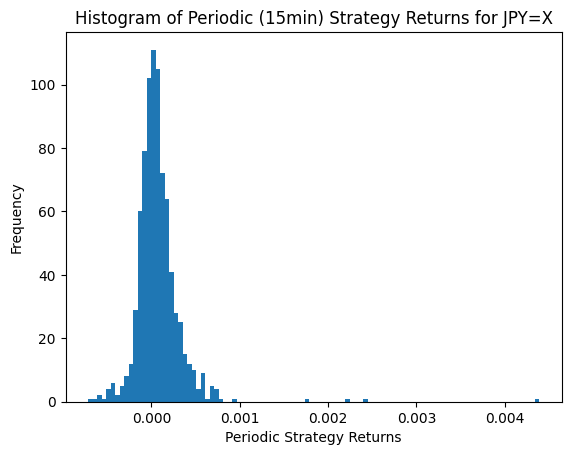

--------------------------------------------------
Total unleverage strategy return for GBPUSD=X is 8.5%
Mean return is 0.0103%
Standard Deviation for mean return is 0.0443%
Number of positive strategy return periods (15min): 515
Number of negative strategy return periods (15min): 288


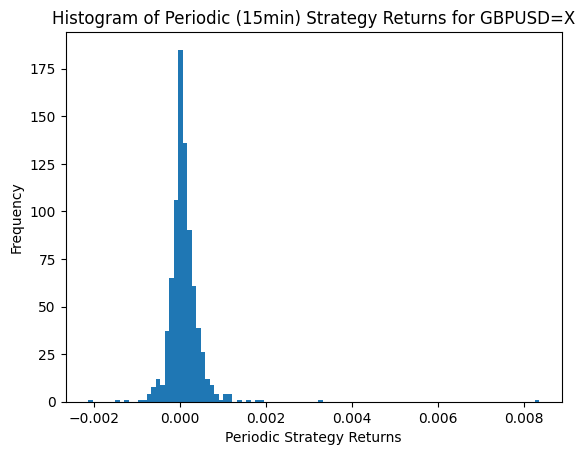

--------------------------------------------------
Total unleverage strategy return for AUDUSD=X is 13.99%
Mean return is 0.0169%
Standard Deviation for mean return is 0.0605%
Number of positive strategy return periods (15min): 539
Number of negative strategy return periods (15min): 271


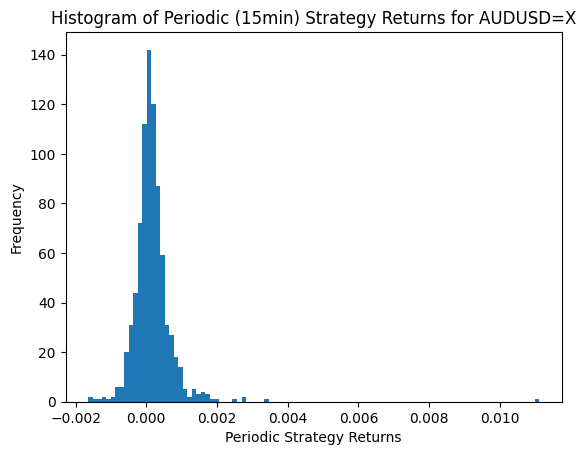

--------------------------------------------------
Total unleverage strategy return for NZDUSD=X is 12.54%
Mean return is 0.0152%
Standard Deviation for mean return is 0.0611%
Number of positive strategy return periods (15min): 481
Number of negative strategy return periods (15min): 269


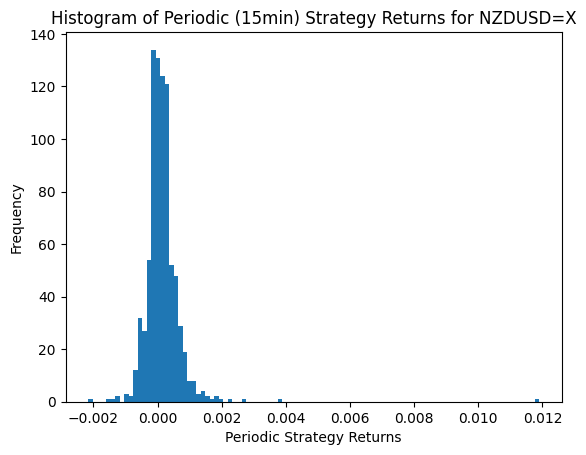

--------------------------------------------------
Total unleverage strategy return for HKD=X is 1.32%
Mean return is 0.0016%
Standard Deviation for mean return is 0.0036%
Number of positive strategy return periods (15min): 536
Number of negative strategy return periods (15min): 243


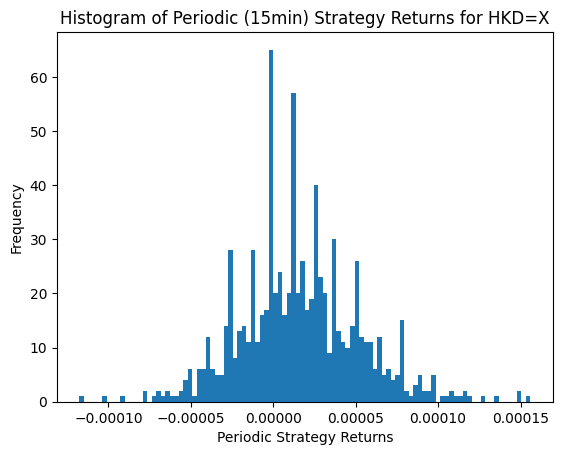

--------------------------------------------------
Total unleverage strategy return for SGD=X is 5.8%
Mean return is 0.0071%
Standard Deviation for mean return is 0.0287%
Number of positive strategy return periods (15min): 508
Number of negative strategy return periods (15min): 287


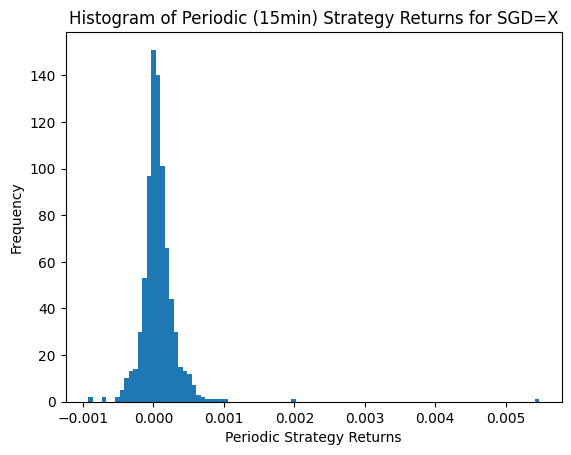

--------------------------------------------------
Total unleverage strategy return for MXN=X is 13.29%
Mean return is 0.0162%
Standard Deviation for mean return is 0.0561%
Number of positive strategy return periods (15min): 504
Number of negative strategy return periods (15min): 301


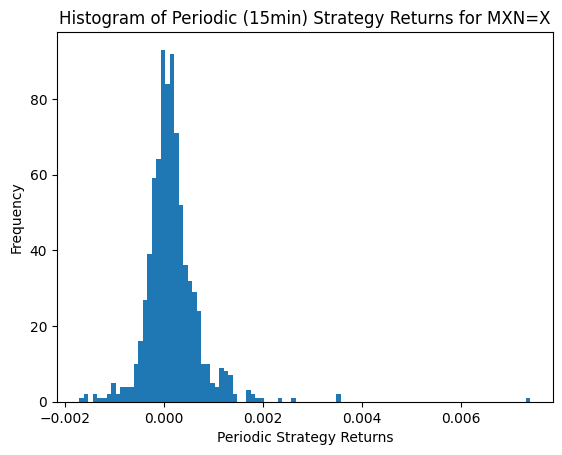

--------------------------------------------------
Total unleverage strategy return for THB=X is 18.45%
Mean return is 0.0227%
Standard Deviation for mean return is 0.0644%
Number of positive strategy return periods (15min): 461
Number of negative strategy return periods (15min): 202


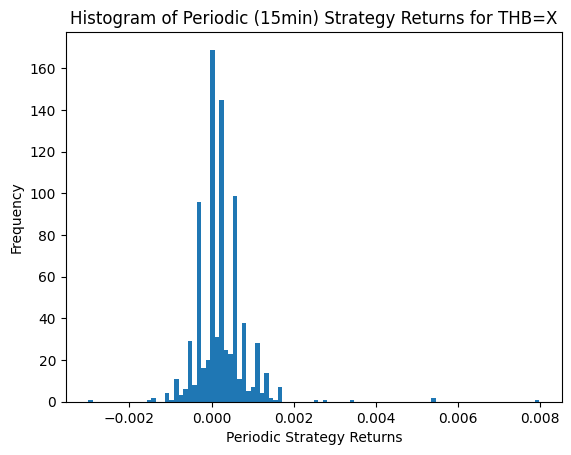

--------------------------------------------------
Total unleverage strategy return for ZAR=X is 20.09%
Mean return is 0.0245%
Standard Deviation for mean return is 0.0711%
Number of positive strategy return periods (15min): 534
Number of negative strategy return periods (15min): 284


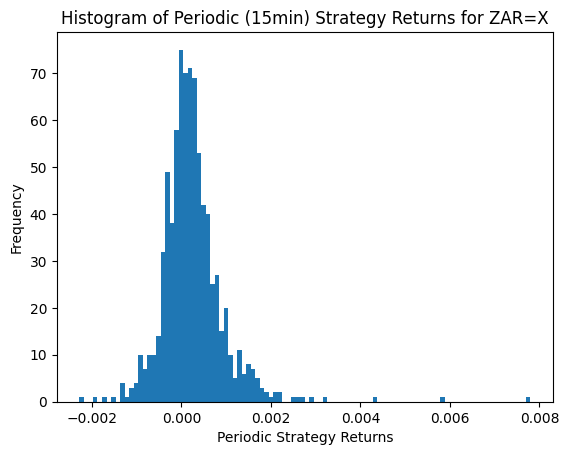

--------------------------------------------------
Total unleverage strategy return for RUB=X is 16.97%
Mean return is 0.0302%
Standard Deviation for mean return is 0.1536%
Number of positive strategy return periods (15min): 293
Number of negative strategy return periods (15min): 217


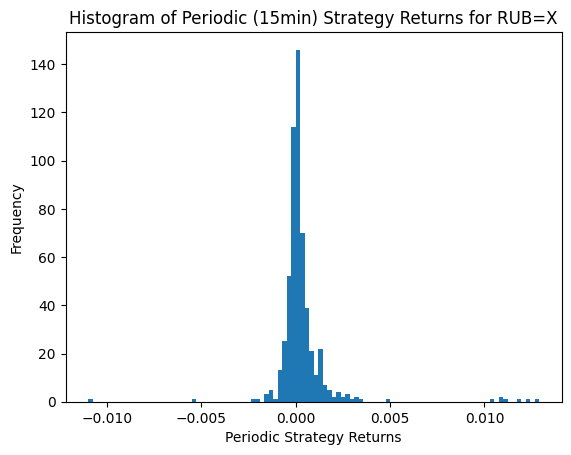

--------------------------------------------------
Total Portfolio Return: 124.86%


In [ ]:
import matplotlib.pyplot as plt

total_return = 0

for symbol in symbols:
  # assumes we buy or sell only on the next close
  #prices3[symbol]["open_returns"] = prices3[symbol]["Open"].pct_change()
  # drop all na, we dont trade if any indicator is na
  data = prices3[symbol].dropna().copy()

  # get the currency pair's model
  model = results[symbol]["best_estimator_"]

  # save the predicted y direction
  #   1 is positive => buy t+1, 0 is not positive => sell t+1
  y_pred = model.predict(data[top_10_features])
  data["signal"] = [1 if x > 0 else -1 for x in y_pred]
  # assumes we buy at around the next close period
  data["buy_on_close"] = data["signal"].shift()
  data["periodic_strategy_return"] = data["buy_on_close"] * data["Returns"]

  positive_count = len(data[data["periodic_strategy_return"] > 0])
  negative_count = len(data[data["periodic_strategy_return"] < 0])

  total_return += data["periodic_strategy_return"].sum()

  print("-" * 50)
  print("Total unleverage strategy return for {} is {}%".format(symbol, round(data["periodic_strategy_return"].sum() *100,2)))
  print("Mean return is {}%".format(round(data["periodic_strategy_return"].mean()*100,4)))
  print("Standard Deviation for mean return is {}%".format(round(data["periodic_strategy_return"].std()*100,4)))

  print(f"Number of positive strategy return periods (15min): {positive_count}")
  print(f"Number of negative strategy return periods (15min): {negative_count}")

  plt.hist(data["periodic_strategy_return"], bins=100)
  plt.title(f"Histogram of Periodic (15min) Strategy Returns for {symbol}")
  plt.xlabel("Periodic Strategy Returns")
  plt.ylabel("Frequency")
  plt.show()

print("-" * 50)
print("Total Portfolio Return: {}%".format(round(total_return*100,2)))

### 3.9 Event Based Backtesting

In [ ]:
class USD_ML_Strategy_15min(Common_Class):

  def get_top10_features(self, open, high, low, close):
    # top 10 features 'DPO_20', 'THERMO_20_2_0.5', 'CFO_9', 'TRUERANGE_1', 'PDIST', 'BBB_5_2.0', 'RVI_14', 'SLOPE_1', 'BULLP_13', 'BOP'
    dpo_df = pandas_ta.trend.dpo(close)
    thermo_df = thermo(high, low)
    cfo_df = pandas_ta.momentum.cfo(close)
    truerange_df = true_range(high, low, close)
    pdist_df = pdist(open, high, low, close)
    bbands_df = bbands(close)
    #cci_df = pandas_ta.momentum.cci(high, low, close)
    rvi_df = rvi(close, high, low)
    slope_df = pandas_ta.momentum.slope(close)
    eri_df = pandas_ta.momentum.eri(high, low, close)
    bop_df = pandas_ta.momentum.bop(open, high, low, close)

    combined = pd.concat([dpo_df, thermo_df, slope_df, cfo_df, truerange_df, bbands_df, rvi_df, pdist_df, eri_df, bop_df], axis=1)
    return combined[top_10_features].copy()

  # Compute the size of the position
  # We use simple percentage where the size is 100%/num_stocks of the available capital
  # min is 1% of available capital
  def get_pos_sizing(self, bar):
    num_stocks = len(self.symbols)
    porportion = 1 / (num_stocks + 1) # we add + 1 to stocks so that there is always some capital leftover
    if porportion < 0.01:
      porportion = 0.01

    (date, tb) = self.get_total_balance(self.symbols[0], bar)
    size = int(tb * porportion)
    return size

  def go_long(self, symbol, bar, quantity = None, dollar = None):

    if self.position[symbol] == -1:
      self.buy_order(symbol, bar, quantity = -self.quantity[symbol]) #to clear previous short position and therefore negative quantity.
    if quantity:
      self.buy_order(symbol, bar, quantity = quantity) # to create new fresh order
    elif dollar:
      if dollar == 'all':
        dollar = self.capital
      if dollar == 'equal':
        dollar = self.get_pos_sizing(bar)
      self.buy_order(symbol, bar, dollar = dollar)


  def go_short(self, symbol, bar, quantity = None, dollar = None):

    if self.position[symbol] == 1:
      self.sell_order(symbol, bar, quantity = self.quantity[symbol]) #to clear previous long vposition
    if quantity:
      self.sell_order(symbol, bar, quantity = quantity) # to create new fresh order
    elif dollar:
      if dollar == 'all':
        dollar = self.capital
      if dollar == 'equal':
        dollar = self.get_pos_sizing(bar)
      self.sell_order(symbol, bar, dollar = dollar)


  def run_strategy(self, models, models_features):
    self.trades = 0
    self.capital = self.initial_capital

    for symbol in self.symbols:
      # calculate all the top technical indicators
      top10_df3 = self.get_top10_features(self.data[symbol]["Open_Price"], self.data[symbol]["High"], self.data[symbol]["Low"], self.data[symbol]["Close_Price"])
      self.data[symbol] = pd.concat([self.data[symbol], top10_df3], axis=1)

      data = self.data[symbol]

      # get the currency pair's model
      model = models[symbol]

      # save the predicted y direction
      #   1 is positive => buy t+1, 0 is not positive => sell t+1
      y_pred = model.predict(data[models_features])
      data["signal"] = [1 if x > 0 else -1 for x in y_pred]

      # assumes we can buy at the next close
      data["buy_on_close"] = data["signal"].shift()


    # start where there is no na, we dont trade if any indicator is na
    start_bar = min(df.dropna().index.argmin() for df in self.data.values() if not df.empty)
    end_bar = max(len(df) for df in self.data.values()) - 1
    port_returns = pd.DataFrame(index=range(end_bar+1), columns=["total_balance"])

    print("start bar: ", start_bar)
    print("end bar: ", end_bar)
    for bar in range(start_bar, end_bar):
      for symbol in self.symbols:
        if bar < self.data[symbol].shape[0]:
          if self.position[symbol] in [0,-1]: # checking no position or short position
            if self.data[symbol]["buy_on_close"].iloc[bar] == 1:
              self.go_long(symbol, bar, dollar="equal") # go with equal porportion to number of stocks
              #self.position[symbol] = 1 # long created
              print("--------")

          if self.position[symbol] in [0,1]: # checking no position or long position
            if self.data[symbol]["buy_on_close"].iloc[bar] == -1:
              self.go_short(symbol, bar, dollar="equal") # go with equal porportion to number of stocks
              #self.position[symbol] = -1 # short created
              print("--------")

      # Save the balance at the end of each bar
      (date, total_balance) = self.get_total_balance(self.symbols[0], bar)
      port_returns.iloc[bar] = total_balance

    print("--------")
    self.last_trade(bar)
    print("-----------")
    print("Performance")
    print("-----------")
    # set initial capital
    port_returns.iloc[start_bar - 1] = self.initial_capital
    # compute log returns from the balances
    port_returns["log_returns"] = np.log ( 1 + port_returns["total_balance"].pct_change() )
    # get and print the performance metrics
    print(self.get_metrics(port_returns["log_returns"], "15M"))

if __name__ == "__main__":
  # Get today's date
  today = date.today()
  # Calculate start date 14 days ago
  start_date = today - timedelta(days=14)
  # Calculate end date 1 days ago
  end_date = today - timedelta(days=1)

  models = dict()
  for symbol in symbols:
    models[symbol] = results[symbol]["best_estimator_"]
  # without any transaction cost
  A = USD_ML_Strategy_15min(symbols, start_date, end_date,"15M",10000, 0, True)
  A.run_strategy(models, top_10_features)

['EURUSD=X', 'JPY=X', 'GBPUSD=X', 'AUDUSD=X', 'NZDUSD=X', 'HKD=X', 'SGD=X', 'MXN=X', 'THB=X', 'ZAR=X', 'RUB=X']
start bar:  0
end bar:  851
Sold 772 of EURUSD=X at 1.0789 USD per EURUSD=X worth 832.88 $
Date :2024-03-29 00:30 | Realised Portfolio Balance: 10832.88
Date :2024-03-29 00:30 | Unrealised Portfolio Balance: -832.88
Date :2024-03-29 00:30 | Total Portfolio Balance: 10000.00
--------
Bought 126168 of JPY=X at 0.0066 USD per JPY=X worth 833.00 $
Date :2024-03-29 00:30 | Realised Portfolio Balance: 9999.89
Date :2024-03-29 00:30 | Unrealised Portfolio Balance: 0.11
Date :2024-03-29 00:30 | Total Portfolio Balance: 10000.00
--------
Sold 660 of GBPUSD=X at 1.2620 USD per GBPUSD=X worth 832.94 $
Date :2024-03-29 00:30 | Realised Portfolio Balance: 10832.83
Date :2024-03-29 00:30 | Unrealised Portfolio Balance: -832.83
Date :2024-03-29 00:30 | Total Portfolio Balance: 10000.00
--------
Sold 1278 of AUDUSD=X at 0.6514 USD per AUDUSD=X worth 832.54 $
Date :2024-03-29 00:30 | Realised

Again, for 15min interval, when spread fees is 1pip

In [ ]:
if __name__ == "__main__":
  # Get today's date
  today = date.today()
  # Calculate start date 14 days ago
  start_date = today - timedelta(days=14)
  # Calculate end date 1 days ago
  end_date = today - timedelta(days=1)

  models = dict()
  for symbol in symbols:
    models[symbol] = results[symbol]["best_estimator_"]

  # assumes spread is 1pip
  A = USD_ML_Strategy_15min(symbols, start_date, end_date,"15M",10000, 0.0001, True)
  A.run_strategy(models, top_10_features)

['EURUSD=X', 'JPY=X', 'GBPUSD=X', 'AUDUSD=X', 'NZDUSD=X', 'HKD=X', 'SGD=X', 'MXN=X', 'THB=X', 'ZAR=X', 'RUB=X']
start bar:  0
end bar:  851
Sold 772 of EURUSD=X at 1.0789 USD per EURUSD=X worth 832.88 $
Date :2024-03-29 00:30 | Realised Portfolio Balance: 10832.80
Date :2024-03-29 00:30 | Unrealised Portfolio Balance: -832.88
Date :2024-03-29 00:30 | Total Portfolio Balance: 9999.92
--------
Bought 126156 of JPY=X at 0.0066 USD per JPY=X worth 832.92 $
Date :2024-03-29 00:30 | Realised Portfolio Balance: 9999.80
Date :2024-03-29 00:30 | Unrealised Portfolio Balance: 0.03
Date :2024-03-29 00:30 | Total Portfolio Balance: 9999.83
--------
Sold 659 of GBPUSD=X at 1.2620 USD per GBPUSD=X worth 831.68 $
Date :2024-03-29 00:30 | Realised Portfolio Balance: 10831.40
Date :2024-03-29 00:30 | Unrealised Portfolio Balance: -831.65
Date :2024-03-29 00:30 | Total Portfolio Balance: 9999.75
--------
Sold 1278 of AUDUSD=X at 0.6514 USD per AUDUSD=X worth 832.54 $
Date :2024-03-29 00:30 | Realised Po

The 15mins model only has a 7% return without any fees (compared to 33% for the 5mins model)
However, due to the lower number of trades, 15mins model is still able to have a higher return of 3.83% (compared to 1%) when there is a spread fee of 1pip